In [2]:


from IPython.display import display, HTML
from IPython.display import Image
display(HTML("""
<style>
.output {
    display: flex;
    align-items: center;
    text-align: center;
}
</style>
"""))

HTML('''
<script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/2.0.3/jquery.min.js"></script>
<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').hide();
 } else {
$('div.jp-CodeCell > div.jp-Cell-inputWrapper').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>
''')

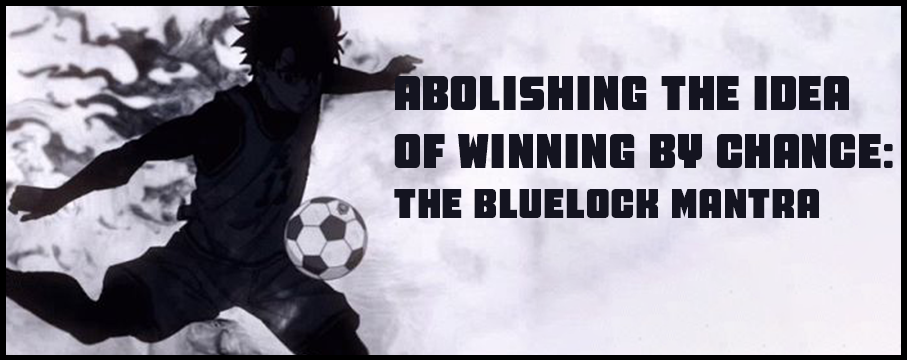

<center><h1 style="color:#000000">A Study on Professional Athletes in the European Football League</h1></center>

In [2]:
# For Data Prep
import numpy as np
import pandas as pd
import sqlite3
from sqlalchemy import create_engine
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm
from collections import Counter
import datetime

# For Dimensionality Reduction
from sklearn.decomposition import PCA, TruncatedSVD

# For Representative-Based Clustering
from sklearn.cluster import KMeans
from pyclustering.cluster.kmedoids import kmedoids
from sklearn.base import clone
from sklearn.metrics import calinski_harabasz_score, silhouette_score, davies_bouldin_score
from scipy.spatial.distance import euclidean, cityblock

# For Heirarchical
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import fcluster
from fastcluster import linkage

# For Density-Based Clustering
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS, cluster_optics_dbscan

# For Plotting
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import cycle
import matplotlib.cm as cm
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from matplotlib import pyplot

In [12]:
# Note: No Gap statistic to lessen runtime

def cluster_range(X, clusterer, k_start, k_stop, actual=None):
    '''
    Accepts the design matrix, the clustering object, the initial and final
    values to step through, and, optionally, actual labels and returns a
    dictionary of the cluster labels, cluster centers, internal validation
    values and, if actual labels is given, external validation values,
    for every k.
    '''
    ys = []
    centers = []
    inertias = []
    chs = []
    scs = []
    dbs = []
    gss = []
    gssds = []
    ps = []
    amis = []
    ars = []
    for k in tqdm(range(k_start, k_stop+1)):
        clusterer_k = clone(clusterer)
        clusterer_k.n_clusters = k
        clusterer_k.fit(X)
        y = clusterer_k.labels_
        ys.append(y)
        chs.append(calinski_harabasz_score(X, y))
        scs.append(silhouette_score(X, y, random_state=1337))
        dbs.append(davies_bouldin_score(X, y))
   
        centers.append(clusterer_k.cluster_centers_)
        inertias.append(clusterer_k.inertia_)
        
        if actual is not None:
            ps.append(purity(actual, y))
            amis.append(adjusted_mutual_info_score(actual, y))
            ars.append(adjusted_rand_score(actual, y))
            
    ret_dict = {'ys': ys, 'centers': centers, 'inertias': inertias,
                'chs': chs, 'scs': scs, 'dbs': dbs}
    
    if actual is not None:
        ret_dict['ps'] = ps
        ret_dict['amis'] = amis
        ret_dict['ars'] = ars
    
    return ret_dict

def plot_clusters(X, ys, centers):
    """Plot clusters given the design matrix and cluster labels"""
    k_max = len(ys) + 1
    k_mid = k_max//2 + 2
    fig, ax = plt.subplots(2, k_max//2, dpi=150, sharex=True, sharey=True, 
                           figsize=(7,4), subplot_kw=dict(aspect='equal'),
                           gridspec_kw=dict(wspace=0.01))
    for k, y in zip(range(2, k_max+1), ys):
        if k < k_mid:
            ax[0][k%k_mid-2].scatter(X[:,0], X[:,1], c=y, s=1, alpha=0.8);
            ax[0][k%k_mid-2].set_title('$k=%d$'%k)
        else:
            ax[1][k%k_mid].scatter(X[:,0], X[:,1], c=y, s=1, alpha=0.8);
            ax[1][k%k_mid].set_title('$k=%d$'%k)
    return ax

def plot_internal(inertias, chs, scs, dbs, gss=None, gssds=None):
    """Plot internal validation values"""
    fig, ax = plt.subplots()
    ks = np.arange(2, len(inertias)+2)
    ax.plot(ks, inertias, '-o', label='SSE')
    ax.plot(ks, chs, '-ro', label='CH')
    ax.set_xlabel('$k$')
    ax.set_ylabel('SSE/CH')
    lines, labels = ax.get_legend_handles_labels()
    ax2 = ax.twinx()
    ax2.plot(ks, scs, '-ko', label='Silhouette coefficient')
    ax2.plot(ks, dbs, '-gs', label='DB')
    ax2.set_ylabel('Silhouette/DB')
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines+lines2, labels+labels2)
    return ax

def pooled_within_ssd(X, y, centroids, dist):
    """Compute pooled within-cluster sum of squares around the cluster mean"""

    dist2 = []
    X = np.array(X)
    y = np.array(y)
    for x in np.unique(y):
        distance = [dist(i, centroids[y[index]])**2 for index,
                    i in enumerate(X) if y[index] == x]
        dist2.append(distance)
    
    w_k = sum([np.sum(i)/(2*len(i)) for i in dist2])
    return w_k

def cluster_range_kmedoids(X, k_start, k_stop, actual=None):
    """
    Accepts the design matrix, the initial and final values to step through,
    and, optionally, actual labels and returns a dictionary of the cluster
    labels, cluster centers, internal validation values, and external
    validation values if actual labels is given, for every k.
    """
    ys = []
    cs = []
    inertias = []
    chs = []
    scs = []
    dbs = []
    gss = []
    gssds = []
    ps = []
    amis = []
    ars = []
    for k in tqdm(range(k_start, k_stop+1)):
        clusterer_k = kmedoids(X, np.arange(k), ccore=True)
        clusterer_k.process()
        y = np.zeros(len(X), dtype=int)
        clusters = clusterer_k.get_clusters()
        for cluster, point in enumerate(clusters):
            y[point] = cluster
        centers = X[clusterer_k.get_medoids()]
        
        se = [euclidean(x, centers[y[i]]) ** 2 for i, x in enumerate(X)]
        sse = np.sum(se)
        ys.append(y)
        cs.append(centers)
        inertias.append(sse)
        chs.append(calinski_harabasz_score(X, y))
        scs.append(silhouette_score(X, y))
        dbs.append(davies_bouldin_score(X, y))

        if actual is not None:
                ps.append(purity(actual, y))
                amis.append(adjusted_mutual_info_score(actual, y))
                ars.append(adjusted_rand_score(actual, y))
                
    out = {
        'ys': ys,
        'centers': cs,
        'inertias': inertias,
        'chs': chs,
        'scs': scs,
        'dbs': dbs,
    }

    if actual is not None:
        out['ps'] = ps
        out['amis'] = amis
        out['ars'] = ars
    return out

def plot1(Z):
    '''
    Accepts a hierarchical clustering encoded as a linkage matrix and
    returns a truncated dendogram plot
    '''
    fig, ax = plt.subplots()
    dn = dendrogram(Z, ax=ax, truncate_mode='level', p=4)
    ax.set_ylabel(r'$\Delta$');
    
    return fig

def ave_nn_dist(n_neighbors, data):
    '''
    Accepts the n_neighbors to consider and the data then returns the average
    distance of a point to its  𝑘=1 nearest neighbor up to  𝑘=𝑛_𝑛𝑒𝑖𝑔ℎ𝑏𝑜𝑟𝑠 
    nearest neighbor as a sorted list.
    '''

    kNN = NearestNeighbors(n_neighbors=n_neighbors)
    kNN.fit(data)
    d = kNN.kneighbors()[0].mean(axis=1)
    
    return np.sort(d).tolist()

def plot_clusters_year(X, ys, centers):
    """Plot clusters given the design matrix and cluster labels"""
    k_max = len(ys) + 1
    k_mid = k_max//2 + 2
    fig, ax = plt.subplots(1, k_max-1, dpi=150, sharex=True, sharey=True, 
                           figsize=(7,4), subplot_kw=dict(aspect='equal'),
                           gridspec_kw=dict(wspace=0.01))
    for k, y in zip(range(2, k_max+1), ys):
            ax[k%k_mid-2].scatter(X[:,0], X[:,1], c=y, s=1, alpha=0.8);
            ax[k%k_mid-2].set_title('$k=%d$'%k)
    return ax

def radarplot(df, title, height, width, bound):
    """Plot radar chart given the dataframe and title"""
    categories = df[0].columns
    fig = make_subplots(rows=1, cols=len(df), 
                        specs=[[{'type': 'polar'} for i in range(len(df))]],
                       subplot_titles=title)

    for index, d in enumerate(df):
        for g in d.index:
            fig.add_trace(go.Scatterpolar(
                r = d.loc[g].values,
                theta = categories,
                fill='toself',
                name = f'{title[index]}cluster {g}'
            ),row=1, col=index+1)

        fig.update_layout(
          polar=dict(
            radialaxis=dict(
              visible=True,
              range=bound # here we can define the range
            )),
            height=height, width=width,
          showlegend=False
        )

    return fig

In [13]:
# SQL Database of the datasets 

# Jojie
engine = create_engine('sqlite:////mnt/data/public/european-soccer/database.sqlite')

# Local
# engine = create_engine('sqlite:///database.sqlite')

df_soccer = pd.read_sql_table('Player_Attributes', engine, index_col='id')
df_players = pd.read_sql_table('Player', engine, index_col='id')


In [14]:
# Convert date columns to datetime format
date = df_soccer['date']
df_soccer.drop(['player_api_id'], axis=1, inplace=True)
df_soccer['date'] = pd.to_datetime(df_soccer['date'])

# Delete rows with other values aside from low medium high

df_soccer['attacking_work_rate'].unique()

df_soccer.isin({'attacking_work_rate': ['nan', 'None', 'le', 'norm', 'stoc', 'y']}).sum()

df_soccer['attacking_work_rate'] = df_soccer['attacking_work_rate'].replace({'nan': np.nan, 'None': np.nan,
                                                                            'le': np.nan, 'norm': np.nan,
                                                                            'stoc': np.nan, 'y': np.nan})

# Delete rows with other values aside from low medium high

df_soccer['defensive_work_rate'].unique()

df_soccer.isin({'defensive_work_rate': ['_0', 'nan', '5', 'ean', 'o',
                                        '1', 'ormal', '7', '2', '8',
                                        '4', 'tocky', '0', '3', '6',
                                        '9', 'es']}).sum()

df_soccer['defensive_work_rate'] = df_soccer['defensive_work_rate'].replace({'_0': np.nan, 'nan': np.nan,
                                                                            '5': np.nan, 'ean': np.nan,
                                                                            'o': np.nan, '1': np.nan,
                                                                            'ormal': np.nan, '7': np.nan,
                                                                            '2': np.nan, '8': np.nan,
                                                                            '4': np.nan, 'tocky': np.nan,
                                                                            '0': np.nan, '3': np.nan,
                                                                            '6': np.nan, '9': np.nan,
                                                                            'es': np.nan})

# Delete rows with null values to clean the data
df_soccer = df_soccer.dropna()

# Onehot encode for the preferred foot then label encoding for the rates
df_soccer = pd.get_dummies(df_soccer, drop_first=True, columns=['preferred_foot'])

rate_mapping = {'low': 1, 'medium': 2, 'high': 3}
df_soccer['attacking_work_rate'] = df_soccer['attacking_work_rate'].map(rate_mapping)
df_soccer['defensive_work_rate'] = df_soccer['defensive_work_rate'].map(rate_mapping)

# Create copy for the year on year analysis
df_soccer_year = df_soccer.copy()

# Get player's most updated stats
df_soccer = df_soccer[df_soccer.groupby('player_fifa_api_id')['date'].transform(lambda x: (x.max() == x))]

# Convert birthday to datetime
df_players['birthday'] = pd.to_datetime(df_players['birthday'])

# Feature Engineer Age from birthday
df = df_players.copy()
now = pd.Timestamp('now')
df['birthday'] = df['birthday'].where(df['birthday'] < now, df['birthday'] -  np.timedelta64(100, 'Y'))   # 2
df['age'] = (now - df['birthday']).astype('<m8[Y]') 

# Age as of 2016
df['age'] = df['age'].astype('int') - 7
df = df.drop(['birthday', 'player_api_id'], axis=1)

# Merge df_soccer and df_player
df_soccer = df_soccer.merge(df, on='player_fifa_api_id', how='left')

# Rearranging columns to get final df_soccer
col_a = df_soccer.columns.tolist()[:2]
col_b = df_soccer.columns.tolist()[40:44]
col_c = df_soccer.columns.tolist()[2:40]
cols = col_a + col_b + col_c
df_soccer = df_soccer[cols]

# Grouping Columns for Radar Chart
shooting = ['finishing', 'heading_accuracy', 'curve', 'free_kick_accuracy',
            'shot_power', 'long_shots', 'positioning', 'penalties']
ball_control = ['dribbling', 'ball_control']
passing = ['crossing', 'short_passing', 'volleys', 'long_passing']
defense = ['aggression', 'interceptions', 'marking', 'standing_tackle',
           'sliding_tackle']
physical = ['acceleration', 'sprint_speed', 'agility', 'reactions', 'balance',
            'jumping', 'stamina', 'vision']
goalkeeping = ['gk_diving', 'gk_handling', 'gk_kicking', 'gk_positioning',
               'gk_reflexes']

<h1 style="color:#000000">I. Executive Summary</h1>

Soccer is a two-team sport composed of eleven(11) players per team who competes to score goals by getting the ball into the opposing team's goalpost. The modern version of the sport as we know it today was popularized in England in the 19th century. It is considered to be one of the most widely played and watched sports in the world that features major international tournaments and highly skilled players.

It is the goal of every professional team to create the possible team they can out of the pool of players. This responsibility is handled by the team's scouts and managers. However, these managers cannot just pick players based on popularity or ability to score alone as it will ruin the team's chemistry. To optimize a soccer team, one must select players of varying specialties such as scoring, defending, play-making, goalkeeping, and whatnot, to ensure a perfect balance between roles and at the same time cover each other's weaknesses. Just as how individual skill is imperative, it is also equally important to give focus on team dynamics and choose players who complement each other on and off the field to work cohesively as a single unit.

This project aims to build a tool for scouts and managers that determines the natural playing position of players using dimensionality reduction and clustering. The use of clustering will uncover patterns and structures in data that may not be immediately apparent to the human eye. By doing so, we can create gain insights and be able to create the perfect team.

There are endless applications to this project which include but are not limited to the following:
1. Roster Creation
2. "My Manager" game mode in soccer-themed video games
3. Moving a player to a different position that better suits him.
4. Customized Training Program
5. Player Trades
6. Formulation of in-game tactics

<h1 style="color:#000000">II. Problem Statement</h1>

As scouts and managers for an international team, how can we cluster players based on skills and attributes to match team expectations and aid in player selection for creating the ultimate pool of players for the Upcoming Seasons of the UEFA Europa League.

<h1 style="color:#000000">III. Motivation</h1>

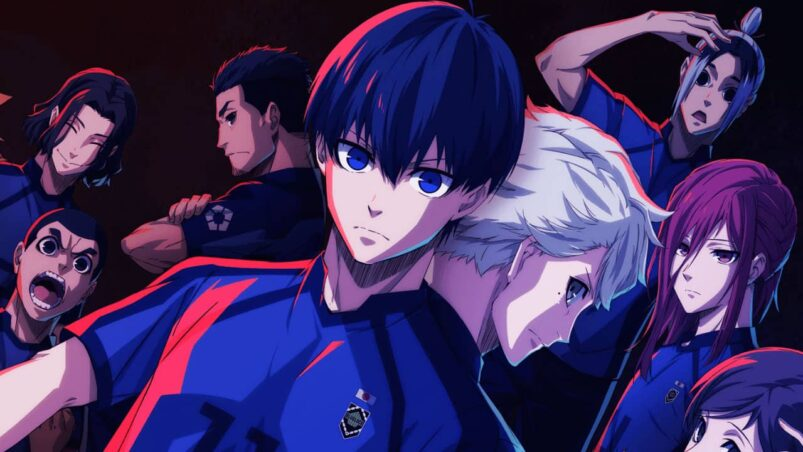

Soccer or football as called in most countries including Europe, South America, and Asia is an extremely popular sport that is watched by millions of fans globally. Although the sport attracts large audiences, the details and intricacies of the sport remain unclear to some people. However, the sport gained another boost to its popularity with the release of the newest anime in the fall of 2022 called Blue Lock.

Blue Lock is a Shonen (aimed primarily at young male audiences, typically characterized by actioned-filled plots) that features high school soccer players and a man who wants to create the ultimate striker for the Japanese national soccer team. The anime was ranked among the most-watched anime in December 2022.

The proponents of this study are fans of Blue Lock and aim to apply the learning from both the anime and course to provide insights into the European Soccer League.

<h1 style="color:#000000">IV. Data Source</h1>

**European Soccer Database**

This dataset is available in the jojie public dataset repository. It contains player and team information on Europe League. Below is a quick summary of the database contents.

Filepath: /mnt/data/public/european-soccer

**Database Summary:**
- +25,000 matches
- +10,000 players
- 11 European Countries with their lead championship
- Seasons 2008 to 2016
- Players and Teams' attributes* sourced from EA Sports' FIFA video game series, including the weekly updates
- Team line up with squad formation (X, Y coordinates)
- Betting odds from up to 10 providers
- Detailed match events (goal types, possession, corner, cross, fouls, cards etc…) for +10,000 matches
- New table containing teams' attributes from FIFA

**Original Data Source**
This dataset was collected and processed by HUGO MATHIEN from the following sources. 
- http://football-data.mx-api.enetscores.com/ : scores, lineup, team formation and events
- http://www.football-data.co.uk/ : betting odds. Click here to understand the column naming system for betting odds:
- http://sofifa.com/ : players and teams attributes from EA Sports FIFA games. FIFA series and all FIFA assets property of EA Sports.

The dataset can be downloaded from kaggle: https://www.kaggle.com/datasets/hugomathien/soccer

<h3><u>Player Attributes Dataset</u></h3>

- This dataset contains the player attribute information. This part of the database is sourced from the FIFA video game series, which is the best representation of the players' ability in the sport of soccer.


<h3><u>Player Dataset</u></h3>

- This dataset contains the player information such as player id, player name, birthday, height, and weight.

<br />

<h1 style="color:#000000">V. Data Exploration</h1>

<center><h3 style="color:#000000"><u>Raw Data Description</u></h3></center>

<span style="font-size: 16px">
    <center><b>Table 1. Player Attributes Raw Data Description</b></center>
</span>
    
|<center>Variable Name</center>|<center>Data type</center>|<center>Variable Caterogy</center>|<center>Description</center>
|:---|:---|:---|:---|
|id|integer|ordinal|Database ID
|player_fifa_api_id|integer|nominal|Player FIFA ID
|player_api_id|integer|nominal|Player ID
|date|string|string|Date of stat recording
|overall_rating|integer|nominal|General performance quality and value of the player representing the key positional skills and international reputation rated between 1-99.
|potential|integer|nominal|Maximum Overall rating expected to be reached by a player in the top of his career rated between 1-99.
|preferred_foot|string|categorical|A player's preferred foot. Either Right or Left.
|attacking_work_rate|string|categorical|How a player participates in attacks. Rated as low, medium and high.
|defensive_work_rate|string|categorical|How a player participates in defensive plays. Rated as low, medium and high.
|crossing|integer|nominal|The quality and accuracy of a player’s crosses. Rated between 1-99.
|finishing|integer|nominal|The ability of a player to score. Rated between 1-99.
|heading_accuracy|integer|nominal|A player’s accuracy when using the head to pass, shoot or clear the ball. Rated between 1-99.
|short_passing|integer|nominal|A player’s accuracy for the short passes. Rated between 1-99.
|volleys|integer|nominal|The ability of a player to perform volleys. Rated between 1-99.
|driblling|integer|nominal|A player’s ability to carry the ball and past an opponent. Rated between 1-99.
|curve|integer|nominal|A player’s ability to curve the ball when passing and shooting. Rated between 1-99.
|free_kick_accuracy|integer|nominal|The precision with which a player takes free kicks. Rated between 1-99.
|long_passing|integer|nominal|A player’s accuracy for the long passes. Rated between 1-99.
|ball_control|integer|nominal|A player’s ability to keep possession of the ball. Rated between 1-99.
|acceleration|integer|nominal|The rate at which a player’s running speed increases. Rated between 1-99.
|sprint_speed|integer|nominal|Defines the speed rate of a player’s sprinting. Rated between 1-99.
|agility|integer|nominal|Determines a player’s ability to manage and control the ball quickly and gracefully. Rated between 1-99.
|reactions|integer|nominal|A player’s reaction time in response to events taking place around them. Rated between 1-99.
|balance|integer|nominal|The even distribution of enabling a player to remain upright and keep going. Rated between 1-99.
|shot_power|integer|nominal|The strength of a player’s shoots. Rated between 1-99.
|jumping|integer|nominal|The ability of a player to jump off the ground for headers. Rated between 1-99.
|stamina|integer|nominal|A player’s ability to sustain prolonged physical or mental effort. Rated between 1-99.
|strength|integer|nominal|The quality or state of being physically strong. Rated between 1-99.
|long_shots|integer|nominal|A player’s accuracy for the shots taking from long distances. Rated between 1-99.
|aggression|integer|nominal|A player’s degree of aggressiveness. Rated between 1-99.
|interceptions|integer|nominal|The ability of a player to intercept the ball. Rated between 1-99.
|positioning|integer|nominal|Defines a player’s ability to spot open space and move into good positions that offer an attacking advantage. Rated between 1-99.
|vision|integer|nominal|A player’s mental awareness about his teammates’ positioning, for passing the ball to them. Rated between 1-99.
|penalties|integer|nominal|A player’s accuracy for taking penalty shots. Rated between 1-99.
|marking|integer|nominal|The ability of a player to mark an opponent. Rated between 1-99.
|standing_tackle|integer|nominal|The ability of performing standing tackle. Rated between 1-99.
|sliding_tackle|integer|nominal|The ability to pull off a sliding tackle. Rated between 1-99.
|gk_diving|integer|nominal|Determines a player's ability to dive as a goalkeeper. Rated between 1-99.
|gk_handling|integer|nominal|Determines a player's ability to handle the ball and hold onto it as a goalkeeper. Rated between 1-99.
|gk_kicking|integer|nominal|Determines a player's ability to kick the ball as a goalkeeper. Rated between 1-99.
|gk_positioning|integer|nominal|Determines that how well a player is able to perform the positioning on the goal line as a goalkeeper. Rated between 1-99.
|gk_reflexes|integer|nominal|Determines a player's ability and speed to react (reflex) for catching/saving the ball as a goalkeeper. Rated between 1-99.

<span style="font-size: 16px">
    <center><b>Table 2. Player Raw Data Description</b></center>
</span>
    
|<center>Variable Name</center>|<center>Original Data type</center>|<center>Data type</center>|<center>Description</center>
|:---|:---|:---|:---|
|id|integer|ordinal|Database ID
|player_api_id|integer|nominal|Player ID
|player_name|string|string|Player name
|player_fifa_api_id|integer|nominal|Player FIFA ID
|birthday|string|string|Player Birthday
|height|float|nominal|Player Height in centimeters
|weight|integer|nominal|Player weight in pounds

<center><h3 style="color:#000000"><u>Final Data Description</u></h3></center>

<span style="font-size: 16px">
    <center><b>Table 3. Player Attributes Final Data Description</b></center>
</span>
    
|<center>Variable Name</center>|<center>Data type</center>|<center>Variable Caterogy</center>|<center>Description</center>
|:---|:---|:---|:---|
|player_api_id|integer|nominal|Player ID
|date|datetime|datetime|Date of stat recording
|player_name|string|string|Player name
|height|float|nominal|Player Height in centimeters
|weight|integer|nominal|Player weight in pounds
|age|integer|nominal|Player age at year 2016 calculated from birthday 
|overall_rating|integer|nominal|General performance quality and value of the player representing the key positional skills and international reputation rated between 1-99.
|potential|integer|nominal|Maximum Overall rating expected to be reached by a player in the top of his career rated between 1-99.
|attacking_work_rate|string|categorical|How a player participates in attacks. Rated as low, medium and high encoded as 1, 2 and 3.
|defensive_work_rate|string|categorical|How a player participates in defensive plays. Rated as low, medium and high encoded as 1, 2 and 3.
|crossing|integer|nominal|The quality and accuracy of a player’s crosses. Rated between 1-99.
|finishing|integer|nominal|The ability of a player to score. Rated between 1-99.
|heading_accuracy|integer|nominal|A player’s accuracy when using the head to pass, shoot or clear the ball. Rated between 1-99.
|short_passing|integer|nominal|A player’s accuracy for the short passes. Rated between 1-99.
|volleys|integer|nominal|The ability of a player to perform volleys. Rated between 1-99.
|driblling|integer|nominal|A player’s ability to carry the ball and past an opponent. Rated between 1-99.
|curve|integer|nominal|A player’s ability to curve the ball when passing and shooting. Rated between 1-99.
|free_kick_accuracy|integer|nominal|The precision with which a player takes free kicks. Rated between 1-99.
|long_passing|integer|nominal|A player’s accuracy for the long passes. Rated between 1-99.
|ball_control|integer|nominal|A player’s ability to keep possession of the ball. Rated between 1-99.
|acceleration|integer|nominal|The rate at which a player’s running speed increases. Rated between 1-99.
|sprint_speed|integer|nominal|Defines the speed rate of a player’s sprinting. Rated between 1-99.
|agility|integer|nominal|Determines a player’s ability to manage and control the ball quickly and gracefully. Rated between 1-99.
|reactions|integer|nominal|A player’s reaction time in response to events taking place around them. Rated between 1-99.
|balance|integer|nominal|The even distribution of enabling a player to remain upright and keep going. Rated between 1-99.
|shot_power|integer|nominal|The strength of a player’s shoots. Rated between 1-99.
|jumping|integer|nominal|The ability of a player to jump off the ground for headers. Rated between 1-99.
|stamina|integer|nominal|A player’s ability to sustain prolonged physical or mental effort Rated between 1-99.
|strength|integer|nominal|The quality or state of being physically strong. Rated between 1-99.
|long_shots|integer|nominal|A player’s accuracy for the shots taking from long distances. Rated between 1-99.
|aggression|integer|nominal|A player’s degree of aggressiveness. Rated between 1-99.
|interceptions|integer|nominal|The ability of a player to intercept the ball. Rated between 1-99.
|positioning|integer|nominal|Defines a player’s ability to spot open space and move into good positions that offer an attacking advantage. Rated between 1-99.
|vision|integer|nominal|A player’s mental awareness about his teammates’ positioning, for passing the ball to them. Rated between 1-99.
|penalties|integer|nominal|A player’s accuracy for taking penalty shots. Rated between 1-99.
|marking|integer|nominal|The ability of a player to mark an opponent. Rated between 1-99.
|standing_tackle|integer|nominal|The ability of performing standing tackle. Rated between 1-99.
|sliding_tackle|integer|nominal|The ability to pull off a sliding tackle. Rated between 1-99.
|gk_diving|integer|nominal|Determines a player's ability to dive as a goalkeeper. Rated between 1-99.
|gk_handling|integer|nominal|Determines a player's ability to handle the ball and hold onto it as a goalkeeper. Rated between 1-99.
|gk_kicking|integer|nominal|Determines a player's ability to kick the ball as a goalkeeper. Rated between 1-99.
|gk_positioning|integer|nominal|Determines that how well a player is able to perform the positioning on the goal line as a goalkeeper. Rated between 1-99.
|gk_reflexes|integer|nominal|Determines a player's ability and speed to react (reflex) for catching/saving the ball as a goalkeeper. Rated between 1-99.
|preferred_foot_right|integer|categorical|A player's preferred foot. 1 for right, 0 for left.

<h3 style="color:#000000">Data Pre-Processing</h3>

**For the Table 1. Player Attributes Raw Data:**
1. Loaded Table 1. Player Attributes Raw Data Description as `df_soccer`.
2. Converted `date` column to datetime format.
3. Deleted rows with other values aside from low medium high in the `attacking_work_rate` column.
4. Deleted rows with other values aside from low medium high in the `defensive_work_rate` column.
5. Deleted rows with null values to clean the data.
6. Label encoded `attacking_work_rate` and `defensive_work_rate` columns.
7. One hot encoded for the `preferred_foot` column.
8. Got player's most updated stats.

**For the Table 2. Player Raw Data:**
1. Loaded Table 2. Player Raw Data Description as `df_player`
2. Converted `birthday` column to datetime format.
3. Feature Engineered `age` from `birthday` column.

**For Table 3. Player Attributes Final Data**
1. Merged `df_soccer` and `df_player` on `player_fifa_api_id` column and named it as the new `df_soccer`.
2. Rearranged columns to get final df_soccer

**For Radar Charts**
1. Created copy of `df_soccer` for the year on year analysis.
2. Grouped columns for the radar chart.

<h3 style="color:#000000">Insights from the Data</h3>

<span style="font-size: 18px">
    <b>98 percent</b> of players are <b>mediocre</b>. Only 2 percent of the playerbase have an overall rating above 81.
</span>

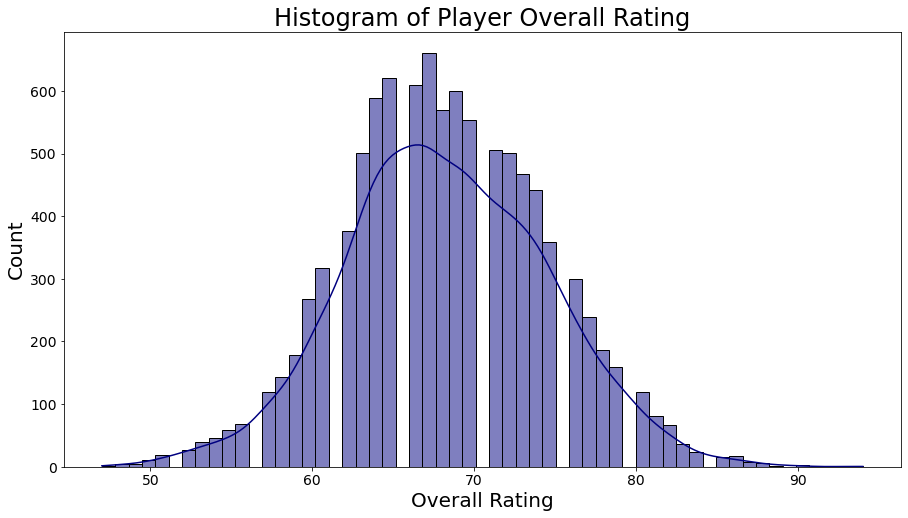

In [15]:
a4_dims = (15, 8)
fig, ax = pyplot.subplots(figsize=a4_dims)
ax = sns.histplot(data=df_soccer,
             x='overall_rating',
             kde=True,
             color='navy',)
 
plt.xlabel("Overall Rating", fontsize = 20)
plt.ylabel("Count", fontsize = 20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.title("Histogram of Player Overall Rating", fontsize = 24);

<span style="font-size: 18px">
    The median player age is <b>28 years old</b>. The youngest in the pool is 16 years old.
</span>

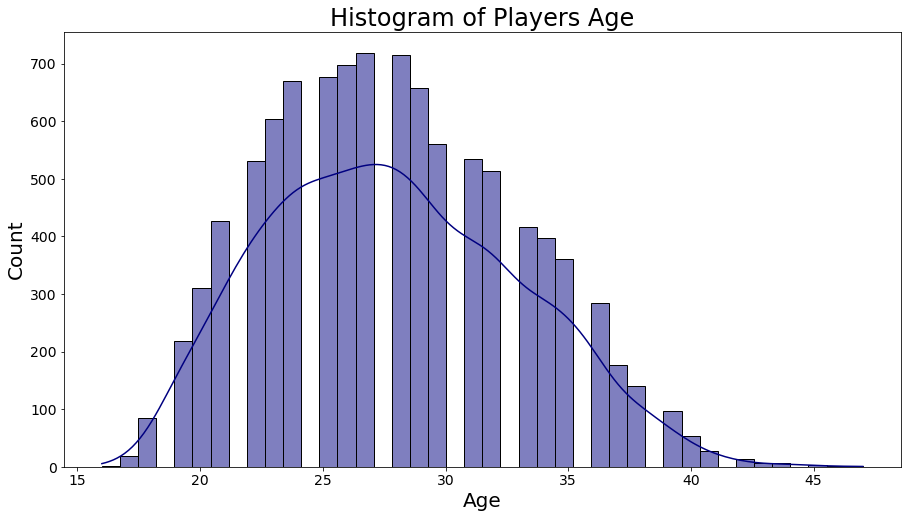

In [16]:
a4_dims = (15, 8)
fig, ax = pyplot.subplots(figsize=a4_dims)
ax = sns.histplot(data=df_soccer,
             x='age',
             kde=True,
             color='navy',)
 
plt.xlabel("Age", fontsize = 20)
plt.ylabel("Count", fontsize = 20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.title("Histogram of Players Age", fontsize = 24);

<span style="font-size: 18px">
    <b>24.5%</b> of players are <b>left-footed</b>. Far from the usual 90-10 ratio of right and left handed players.
</span>

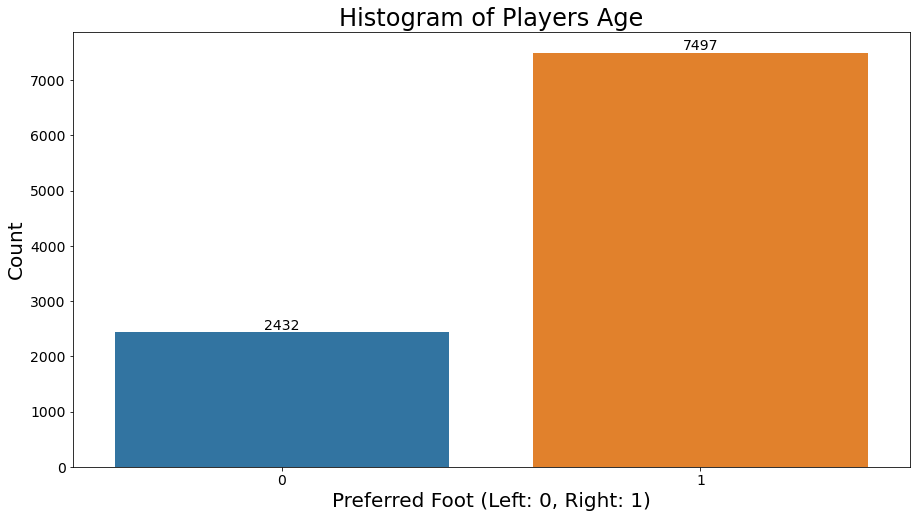

In [17]:
a4_dims = (15, 8)
fig, ax = pyplot.subplots(figsize=a4_dims)
ax = sns.countplot(data=df_soccer, x='preferred_foot_right')
ax.bar_label(ax.containers[0], fontsize=14)

plt.xlabel("Preferred Foot (Left: 0, Right: 1)", fontsize = 20)
plt.ylabel("Count", fontsize = 20)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.title("Histogram of Players Age", fontsize = 24);

In [18]:
sns.pairplot(df_soccer.iloc[:, 3:], diag_kind='kde');

We can observe clear clustering in several scatterplots, specifically for gk_reflexes, gk_positioning, gk_kicking, gk_handling, and gk_diving. We can also observe strongly correlated features like marking, sliding_tackle, and standing tackle. But most other features are well scattered.

<h1 style="color:#000000">VI. Methodology</h1>

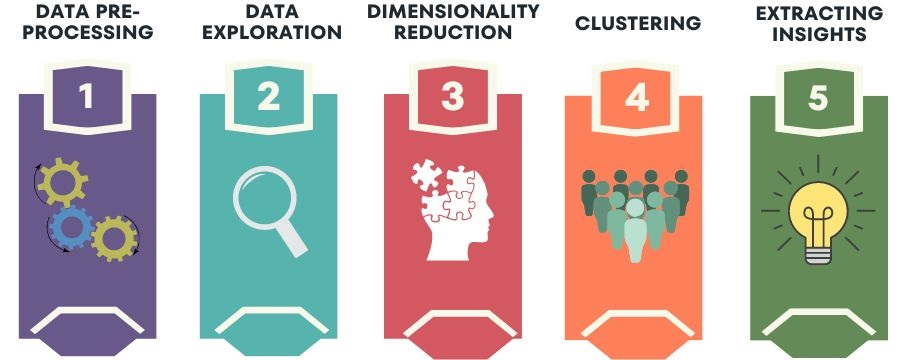

<h1 style="color:#000000">VII. Main Body</h1>

<h2 style="color:#000000">Dimentionality Reduction</h2>

Before we proceed with clustering, we first perform dimensionality reduction on our dataset. The reason for doing so is that data, especially at high dimensionality, can result in poor clustering performance. This is called the curse of dimensionality.

Although it is possible to immediately proceed to clustering, as our data only contains less than 50 dimensions and can be argued as high or low dimensions depending on how we classify the threshold, the advantage of performing dimensionality reduction is that data can be clustered and visualized easier.

We apply both Principal Component Analysis (PCA) and Singular Vector Decomposition (SVD) to this problem. In this case, PCA was exclusively used to project and identify the relationship between features.

In [74]:
player_names = df_soccer['player_name']
player_id = df_soccer['player_fifa_api_id']
X_soccer_unscaled = df_soccer.drop(['player_fifa_api_id', 'date', 'player_name'], axis=1)

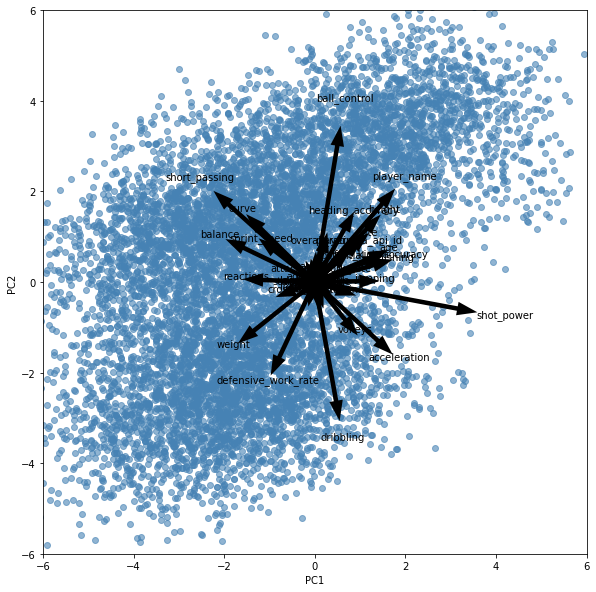

In [21]:
# Scaling Dataset

standard_scaler = StandardScaler()
X_soccer = standard_scaler.fit_transform(X_soccer_unscaled)

# DR with PCA

pca = PCA(n_components=39)
pca.fit(X_soccer)
X_new_pca = pca.transform(X_soccer)
w_pca = pca.components_
variance_explained_pca = pca.explained_variance_ratio_
fig, ax = plt.subplots(1, 1, subplot_kw=dict(aspect='equal'), figsize=(10, 10))
plt.scatter(X_new_pca[:,0], X_new_pca[:,1], c='steelblue', alpha=0.6)
features = df_soccer.columns
for feature, vec in zip(features, w_pca):
    ax.arrow(0, 0, 6*vec[0], 6*vec[1], width=0.1, ec='none', fc='black')
    ax.text(8*vec[0], 8*vec[1], feature, ha='center', color='black')
ax.set_xlim(-6, 6)
ax.set_ylim(-6, 6)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2');

We then check the number of principal components to retain if we want to preserve 80% of the information. This can be measured by the cumulative variance explained. Refer to the plot below.

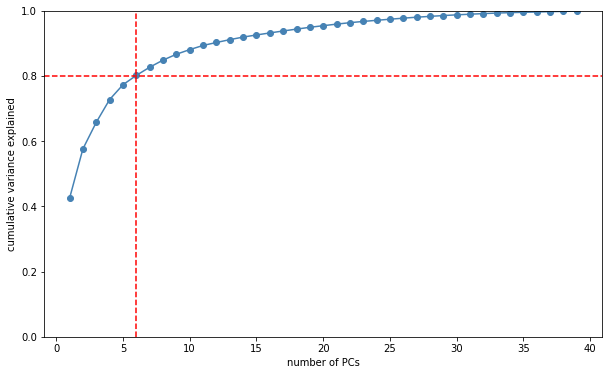

In [22]:
fig, ax = plt.subplots(figsize=(10, 6))
plt.plot(range(1, len(variance_explained_pca)+1), 
         variance_explained_pca.cumsum(), 'o-', c='steelblue')
plt.ylim(0,1)
plt.xlabel('number of PCs')
plt.ylabel('cumulative variance explained')
plt.axhline(y = 0.8, color = 'r', linestyle = '--')

plt.axvline(x = np.where(variance_explained_pca.cumsum() > 0.81)[0][0], color = 'r', linestyle = '--');

Now, the proponents have chosen to use Singular Vector Decomposition (SVD) as the dimensionality reduction technique to be applied to the dataset. This should give us approximately the same result, this is a preference of technique.

We also check the number of components to be retained to preserve 80% of the information. It has been determined that preserving at least 6 components results in a cumulative variance of around 80%. Notice how we got the same values as using Principal Component Analysis (PCA).

In [23]:
# DR with SVD

svd = TruncatedSVD(n_components=38, random_state=1337)
X_new_svd = svd.fit_transform(X_soccer)
variance_explained_svd = svd.explained_variance_ratio_
p_svd = svd.components_

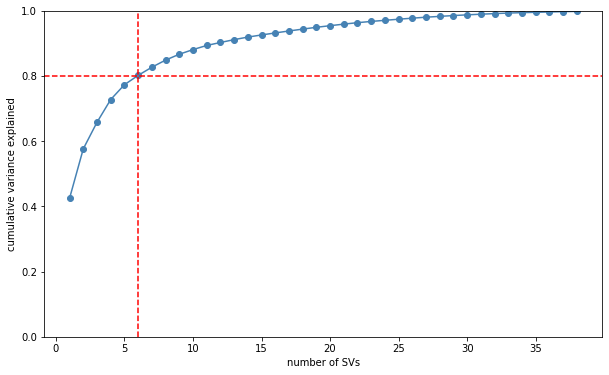

In [24]:
fig, ax = plt.subplots(figsize=(10, 6))
plt.plot(range(1, len(variance_explained_svd)+1), 
         variance_explained_svd.cumsum(), 'o-', c='steelblue')
plt.ylim(0,1)
plt.xlabel('number of SVs')
plt.ylabel('cumulative variance explained')
plt.axhline(y = 0.8, color = 'r', linestyle = '--')
plt.axvline(x = np.where(variance_explained_svd.cumsum() > 0.81)[0][0], color = 'r', linestyle = '--');

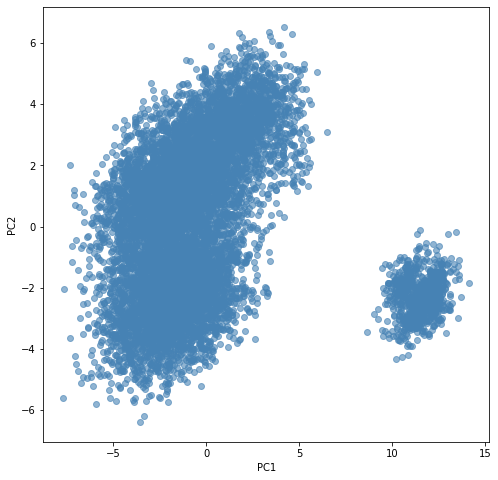

In [25]:
fig, ax = plt.subplots(figsize=(8, 8))
plt.scatter(X_new_svd[:,0], X_new_svd[:,1], c='steelblue', alpha=0.6)
plt.xlabel('PC1')
plt.ylabel('PC2');

Next, we interpret the importance of features in each Singular Vector. According to the first singular vector, which contains the most information, shot_power, and passing are among the most important features of the dataset.

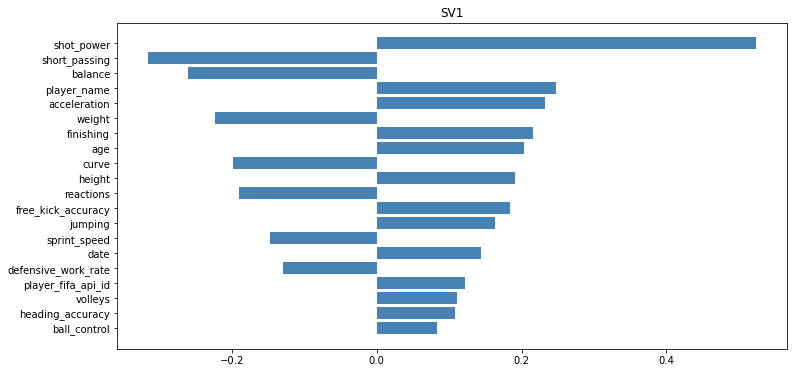

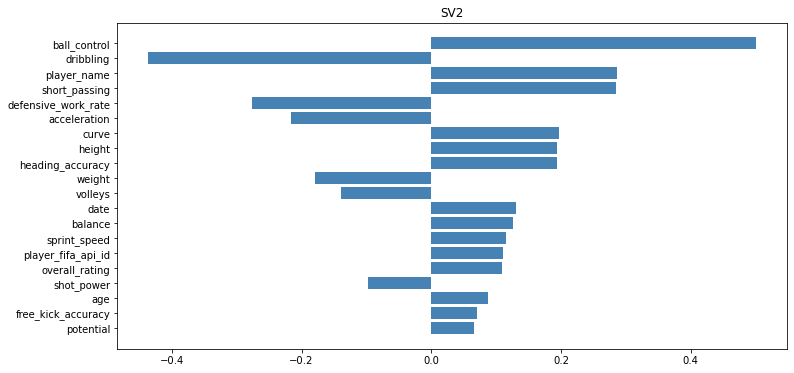

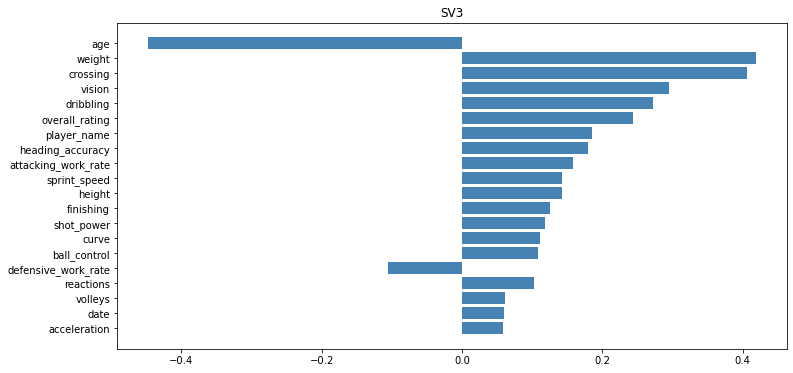

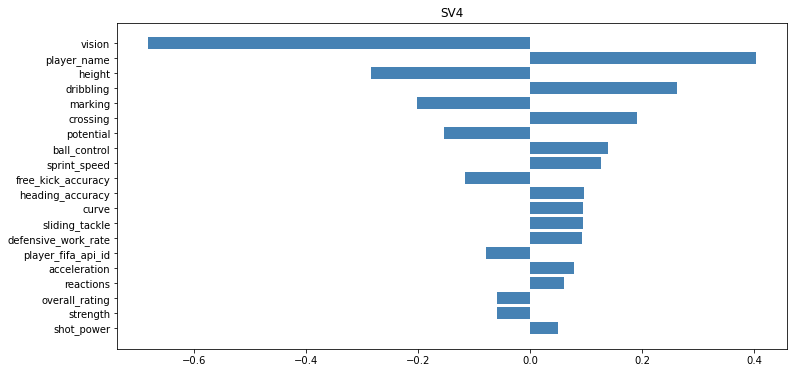

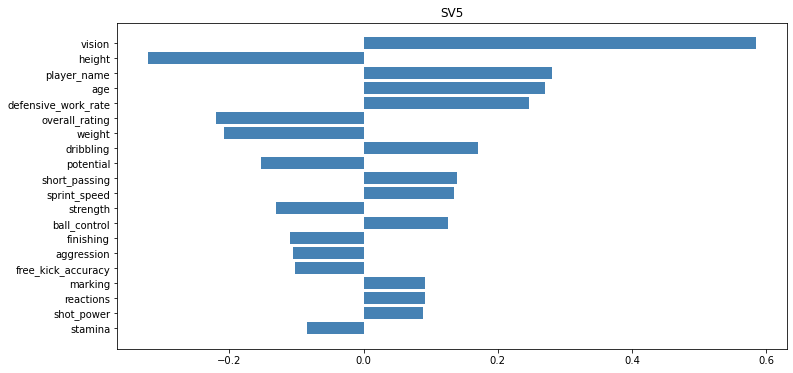

In [26]:
feature_names = df_soccer.columns
for i in range(5):
    fig, ax = plt.subplots(figsize=(12, 6))
    order = np.argsort(np.abs(p_svd[:, i]))[-20:]
    ax.barh([feature_names[o] for o in order], p_svd[order, i], color='steelblue')
    ax.set_title(f'SV{i+1}')

After performing dimensionality reduction, we can now visualize the data using the first two singular vectors. At first glance, it seems that two clusters have been formed, one on the left, and another one on the right. But then again, that is how we would cluster it visually. The question now is, what clusters can we identify using different clustering techniques?

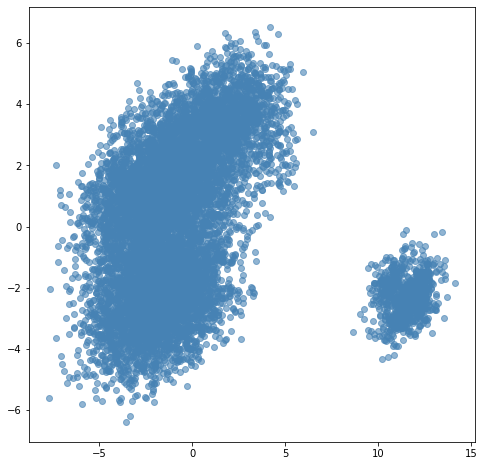

In [27]:
# Current Working Dataset

svd = TruncatedSVD(n_components=6, random_state=1337)
X_new_svd = svd.fit_transform(X_soccer)
fig, ax = plt.subplots(figsize=(8, 8))
plt.scatter(X_new_svd[:,0], X_new_svd[:,1], c='steelblue', alpha=0.6);

<h2 style="color:#000000">Clustering</h2>

After performing dimensionality we can now proceed to perform various clustering techniques. Of course, there is no one correct method to apply, hence we will be applying various techniques and identifying which techniques will work best given the data.

Here are the various clustering techniques/algorithms that we will use for this project:

**Representative-based Clustering**
- K-means
- K-medoids

**Hierarchical Clustering**
- Single Linkage
- Complete Linkage
- Average Linkage
- Ward's Linkage

**Density-based Clustering**
- Density-Based Spatial Clustering of Applications with Noise (DBSCAN)
- Ordering Points To Identify Cluster Structure (OPTICS)

Aside from the methods mentioned above, there are also other clustering techniques such as:
- MiniBatch K-Means
- Affinity Propagation
- Mean shift
- Spectral
- BIRTH
- Gaussian Mixture

However, in this study, we will only stick to the first eight clustering techniques mentioned above.

<h2 style="color:#000000">Representative-Based Clustering</h2>

Representative-based clustering is a method where each cluster is represented by a single object such as a centroid, a medoid, or a set of representatives. The idea behind the technique is to find an object which best describes or summarizes the entire cluster.

Objects in representative-based clustering are represented by features and distance between objects. For distance metrics, what typically is used for representative-based clustering are Euclidean distance, Manhattan distance, and Cosine distance. The metric also varies depending on the type of representative-based clustering algorithm to be used.

One of the advantages of using representative-based clustering is its computational efficiency and ability to handle big data. However, such advantages also have disadvantages such as the assumption of spherical clusters. Now we apply the algorithm.

<span style="font-size: 18px">
    <b>K-means Clustering</b>
</span>

K-means clustering partitions the dataset into k clusters. However, we first have to identify the best value for k or the number of clusters. We can do so by applying a grid-search algorithm on top of k-means.

But how would we know what value for k is the best? After all, using grid search is only scratching the surface. We use validation criteria.

Validation scores rate the quality of clustering based on four(4) measures. It is said that good clustering has the following characteristics:

* **Compact**: points in the same cluster should be close together
* **Separated**: points not belonging to the cluster should be far from points in the cluster
* **Balanced**: the number of points in each cluster is comparable
* **Parsimonious**: the number of clusters should be as few as possible

Now the question goes, what metrics do we use to somewhat score the quality of our clustering? There are two types, we have the internal validation score and the external validation score. Below are the validation scores that are available to us:

**Internal Validation Criteria**
1. Sum of squares distance to centroids
2. Calinski-Harabasz index
3. Silhouette coefficient
4. Davies-Bouldin index
5. Gap statistic

**External Validation Criteria**
1. Cluster purity
2. Adjusted mutual information
3. Adjusted Rand index.

It must be noted that this project is unsupervised learning, hence our data has no labels. Therefore, we can only measure the quality of clustering using the internal validation criteria. We will also omit Gap statistic as it is computationally expensive.

100%|██████████| 8/8 [00:31<00:00,  3.89s/it]


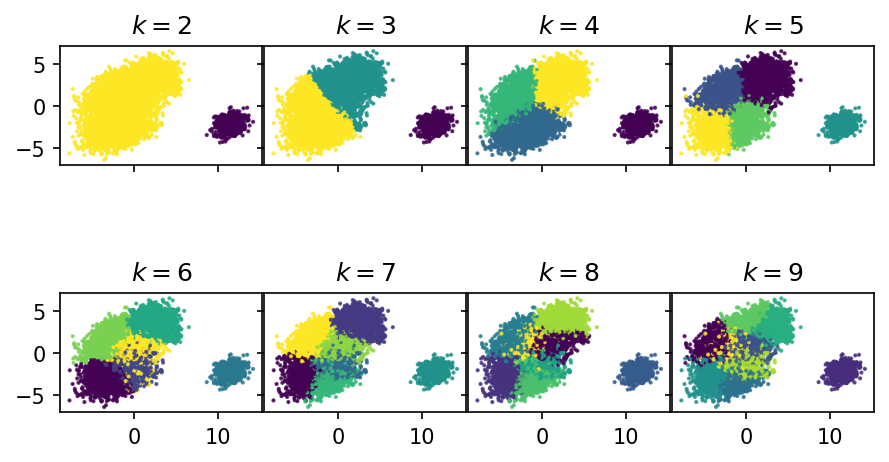

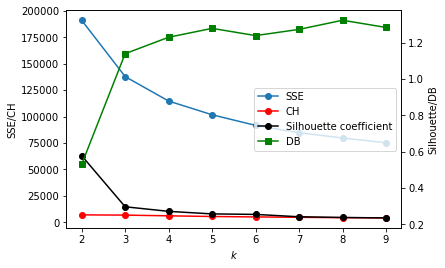

In [28]:
# KMeans

res_soccer = cluster_range(X_new_svd, KMeans(random_state=1337), 2, 9)
plot_clusters(X_new_svd, res_soccer['ys'], res_soccer['centers']);

plot_internal(res_soccer['inertias'], res_soccer['chs'], res_soccer['scs'],
              res_soccer['dbs']);

It can be a handful looking at the plots above. Let's take a step back and summarize the results based on the following criteria:

* **Visual**: Looking at the plot, it seems that k=2, k=3, k=4, and k=5 look the most visually appealing.
* **SSE**: For SSE, we want to use the elbow method to identify the best value for k. According to the elbow method, the best value for k is k=3
* **CH**: For the CH index, we cannot judge the largest value based on the plot alone. However, after taking the values, k=2 is the best.
* **SC**: For the Silhouette coefficient, the heuristic is to get a value that is closest to 0.5 in the plot above, we can see that it is k=2
* **DB**: For the DB index, we want a value that is close to zero but not 0. The plot above shows us that k=2 is the closest value to zero, hence the best value for k.

To summarize, based on the various validation scores. It seems that k=2 is the best. Let us try other methods as well!

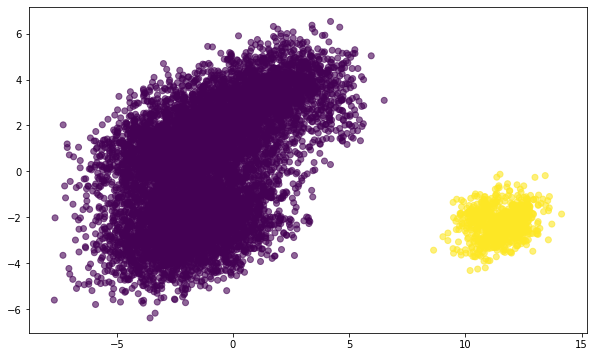

In [29]:
# k=2
fig, ax = plt.subplots(figsize=(10, 6))
cluster_labels = KMeans(2, random_state=214).fit_predict(X_new_svd)
plt.scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels, alpha=0.6);

<span style="font-size: 18px">
    <b>K-medoids Clustering</b>
</span>

We do the same steps but this time we use K-medoids clustering. Earlier for K-means, we used the centroid, for K-medoids however, what we will be using is the medoid of the cluster.

A medoid is defined as an object that is the most centrally located object in a cluster. Unlike the mean or centroid, a medoid is an actual object from the data. This makes the technique more robust to outliers and more interpretable than K-means.

100%|██████████| 8/8 [15:23<00:00, 115.48s/it]


<AxesSubplot:xlabel='$k$', ylabel='SSE/CH'>

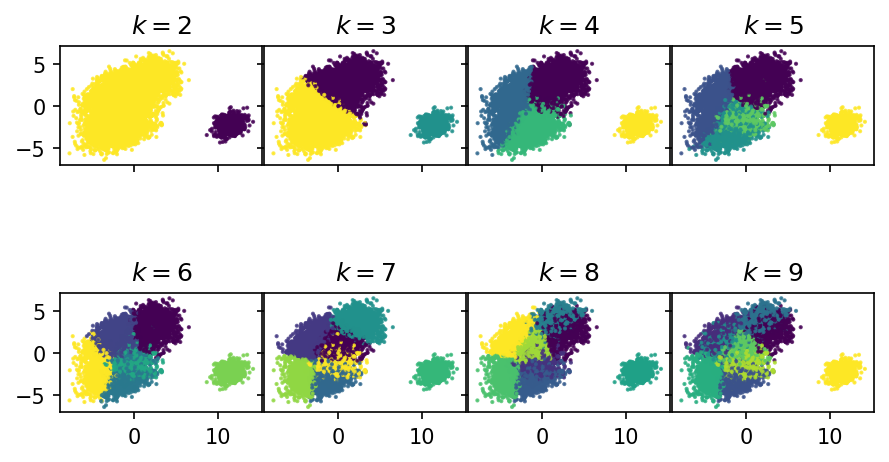

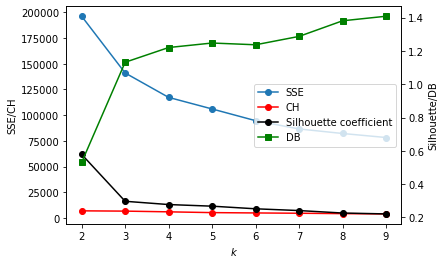

In [30]:
# KMedoid

res_soccer2 = cluster_range_kmedoids(X_new_svd, 2, 9)
plot_clusters(X_new_svd, res_soccer2['ys'], res_soccer2['centers']);

plot_internal(res_soccer2['inertias'], res_soccer2['chs'], res_soccer2['scs'],
              res_soccer2['dbs']);

Let us summarize the results:

* **Visual**: Looking at the plot, it seems that k=2, k=3, k=4 look the most visually appealing.
* **SSE**: For SSE, we want to use the elbow method to identify the best value for k. According to the elbow method, the best value for k is k=3
* **CH**: For the CH index, we cannot judge the largest value based on the plot alone. However, after taking the values, k=2 is the best.
* **SC**: For the Silhouette coefficient, the heuristic is to get a value that is closest to 0.5 in the plot above, we can see that it is k=2
* **DB**: For the DB index, we want a value that is close to zero but not 0. The plot above shows us that k=2 is the closest value to zero, hence the best value for k.

To summarize, based on the various validation scores. It seems that k=2 is the best.

In [31]:
kmo = kmedoids(X_new_svd, np.arange(2), ccore=True)
kmo.process()
clusters = kmo.get_clusters()
y_predict = np.zeros(len(X_new_svd))
for cluster, point in enumerate(clusters):
    y_predict[point] = cluster

There is how k=2 will look enlarged. The black boxes also represent the medoid for each cluster.

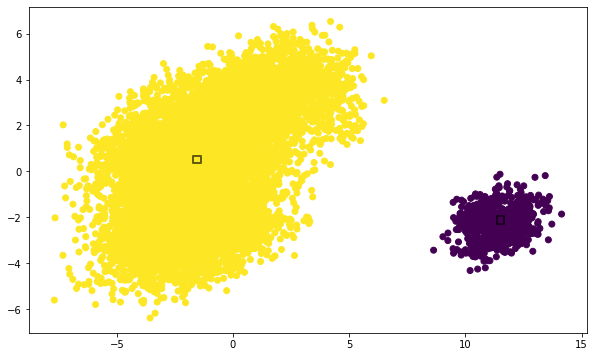

In [32]:
fig, ax = plt.subplots(figsize=(10, 6))
plt.scatter(X_new_svd[:,0], X_new_svd[:,1], c=y_predict)
kmedoids_centroids_new = X_new_svd[kmo.get_medoids(), :]
plt.scatter(kmedoids_centroids_new[:,0],
            kmedoids_centroids_new[:,1],
            s=60,
            c=range(len(clusters)),
            marker='s',
            ec='k',
            lw=2,
            alpha=0.6);

<span style="font-size: 18px">
    <b>Comparing Kmeans and Kmedoids</b>
</span>

The table below summarizes the intervalidation scores for both K-means and K-medoids.

In [33]:
# Compare scores

data_repre = {'SSE_kmeans': res_soccer['inertias'],
              'SSE_kmedoids': res_soccer2['inertias'],
              'CH_kmeans': res_soccer['chs'],
              'CH_kmedoids': res_soccer2['chs'],
              'SH_kmeans': res_soccer['scs'],
              'SH-kmedoids': res_soccer2['scs'],
              'DB_kmeans': res_soccer['dbs'],
              'DB_kmedoids': res_soccer2['dbs']
}
df_repre = pd.DataFrame(data_repre, index=range(2,10))
display(df_repre)

,SSE_kmeans,SSE_kmedoids,CH_kmeans,CH_kmedoids,SH_kmeans,SH-kmedoids,DB_kmeans,DB_kmedoids
2,191098.744792,196082.311287,7021.848572,7021.848572,0.578424,0.578424,0.530651,0.530651
3,137796.445095,140960.210538,6788.338178,6746.787690,0.297294,0.296817,1.139579,1.131903
4,114665.862920,117243.204476,6105.280234,6052.480948,0.272083,0.277159,1.229922,1.220332
5,101696.000561,105994.567403,5478.857210,5297.183698,0.258089,0.267416,1.278782,1.247384
6,91658.725981,94616.386215,5079.891596,4967.896808,0.255318,0.251651,1.239057,1.236851
7,84705.550629,86577.422145,4716.008897,4689.459277,0.242296,0.241070,1.273116,1.287164
8,79735.105436,82168.135429,4382.206358,4309.714929,0.238392,0.226264,1.323456,1.380902
9,75229.147070,78256.701910,4137.948131,4029.793054,0.236000,0.220911,1.283824,1.408247


<h2 style="color:#000000">Hierarchical Clustering</h2>

We are done with representative-based clustering. Let us now proceed to the next clustering type which is hierarchical clustering.

Hierarchical clustering is a method that builds a hierarchy of clusters by either merging or splitting existing clusters. This is best represented by a dendrogram, which is a tree-like structure that illustrates the relationship between clusters and objects in a dataset.

Hierarchical clustering can be split into two types: Agglomerative clustering and Divising clustering. For now, we will only focus on agglomerative clustering, which is a bottom-to-top approach to clustering. It starts with each object as a separate cluster and merges the closest object or clusters until all objects are members of a cluster.

The advantage of hierarchical cluster is its flexibility and it does not assume spherical clusters. Visualization is also one of the strengths of this method as it uses a dendrogram to define the clusters. Dendrograms are high interpretable plots.

We can further narrow down Agglomerative clustering into four(4) types (note: there are more than four methods but we will only focus on the four most used):

1. Single Linkage
2. Complete Linkage
3. Average Linkage
4. Ward's Linkage

Let's now try all four types of agglomerative clustering.

<span style="font-size: 18px">
    <b>Single Linkage</b>
</span>

Single linkage is one of the many linkage criteria in hierarchical clustering. The similarity between two clusters is defined as the minimum distance between any two objects, one from each cluster. It is sensitive to the presence of outliers and can dominate the linkage between clusters which may result in the formation of large, elongated, and unnatural clusters.

Let's apply single linkage to our dataset.

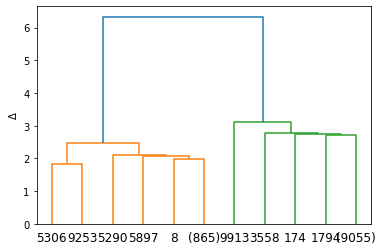

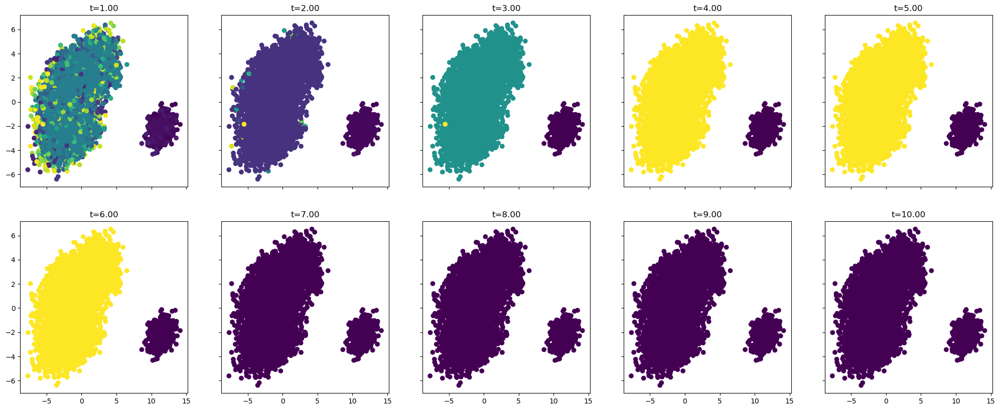

In [34]:
# Single
Y = linkage(X_new_svd, method='single')

plot1(Y);

cost = np.arange(1, 11, 1)
fig, ax = plt.subplots(2, len(cost)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))
for index, t in enumerate(cost):
    y_predict_soccer = fcluster(Y, t=t, criterion='distance')
    if index < (len(cost)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1],
                             c=y_predict_soccer)
        ax[0][index].set_title(f't={t:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1],
                                          c=y_predict_soccer)
        ax[1][index-len(cost)//2].set_title(f't={t:.2f}')

Above, we have generated a simplified dendrogram and a grid-search implementation to identify the best value for k. Here, we use various numbers of threshold t, to determine the optimal cutoff threshold from our dendrogram. Similarly, we can also use the gap method for hierarchical clustering to identify the threshold value t. 

By looking at the dendrogram, we can set the threshold t between the value of t=4 and t=6. We can also verify from the grid-search implementation what t=4, t=5, and t=6 look like.

Luckily for us, there is a good amount of separation between the visually inherent cluster, which makes single linkage a decent technique to use for this dataset.

We also looked at the internal validation criteria at different threshold values to help us find the optimal hyperparameters for the clustering. For the Agglomerative clustering methods, we only use Silhouette score, and the DB index to evaluate the resulting clusters.

100%|██████████| 15/15 [00:39<00:00,  2.63s/it]


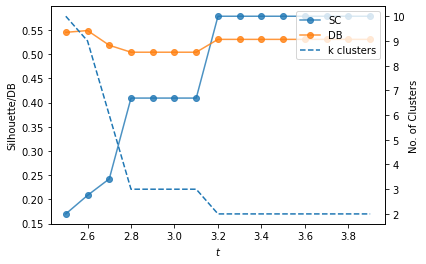

In [35]:
epss = np.arange(2.5, 4, 0.1)

fig, ax = plt.subplots()
ax2 = ax.twinx()

SH = []
DB = []
CH = []
Y = linkage(X_new_svd, method='single')
for index, eps in enumerate(tqdm(epss)):
    cluster_labels = fcluster(Y, t=eps, criterion='distance')
    SH.append(silhouette_score(X_new_svd, cluster_labels))
    DB.append(davies_bouldin_score(X_new_svd, cluster_labels))
    CH.append(cluster_labels.max())
ax.plot(epss, SH, '-o', label=f'SC', alpha=0.8)
ax.plot(epss, DB, '-o', label=f'DB', alpha=0.8)
ax2.plot(epss, CH, '--', label=f'k clusters')
ax.set_xlabel(r'$t$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

The internal validation criteria shows us that:
* **SC**: The silhouette score is closest to our heuristic of 0.5 at t=3.2 where the number of clusters is k=2. 
* **DB**: Since we want a value that is close to zero but not 0. The DB index value seen in the plot above suggests that the optimal clustering is at t=3.1.By looking at the dashed line, we can see that the number of clusters at t=3.1 is k=3.

For single linkage, we decided to go with t=3.2 since the third cluster produced for t=3.1 appears to be a single point cluster similar to the clustering shown for t=3.

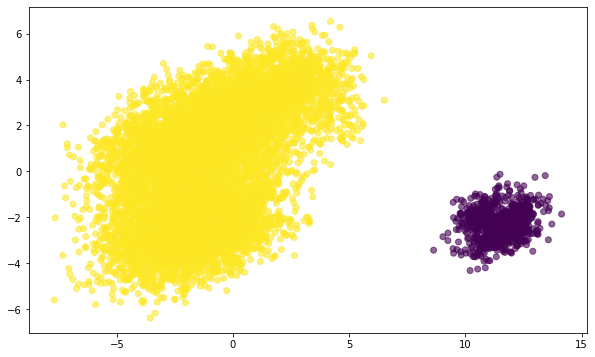

In [36]:
fig, ax = plt.subplots(figsize=(10, 6))
Y = linkage(X_new_svd, method='single')
cluster_labels = fcluster(Y, t=3.2, criterion='distance')
plt.scatter(X_new_svd[:, 0], X_new_svd[:, 1], c=cluster_labels, alpha=0.6);

Let us try the three other methods as well and continue the discussion after Ward's Linkage.

<span style="font-size: 18px">
    <b>Complete Linkage</b>
</span>

Complete linkage is another hierarchical clustering criterion that determines the similarity between two clusters by taking into account the largest distance between two points, one from each cluster. It is the amount of dissimilarity that determines the formation of a new cluster.

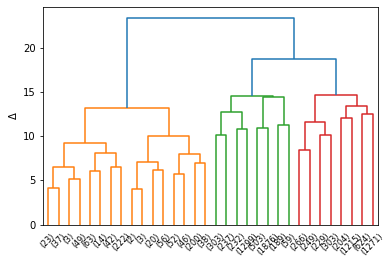

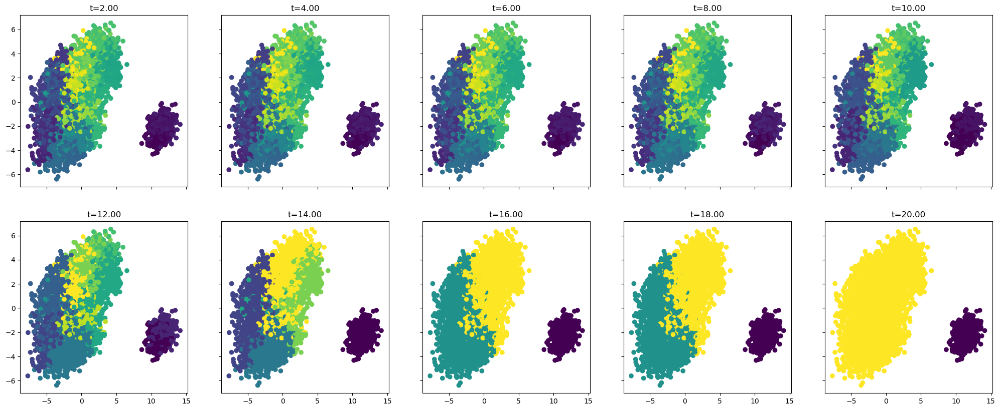

In [37]:
# Complete
Y = linkage(X_new_svd, method='complete')

plot1(Y);

cost = np.arange(2, 22, 2)
fig, ax = plt.subplots(2, len(cost)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))
for index, t in enumerate(cost):
    y_predict_soccer = fcluster(Y, t=t, criterion='distance')
    if index < (len(cost)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1],
                             c=y_predict_soccer)
        ax[0][index].set_title(f't={t:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1],
                                          c=y_predict_soccer)
        ax[1][index-len(cost)//2].set_title(f't={t:.2f}')

We look for the optimal hyperparameter using the internal validation criteria

100%|██████████| 14/14 [00:33<00:00,  2.41s/it]


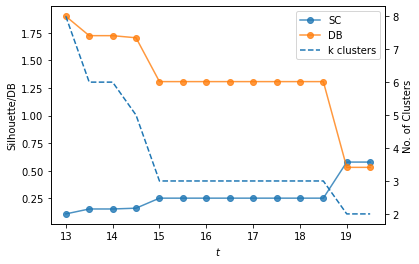

In [38]:
epss = np.arange(13, 20, 0.5)

fig, ax = plt.subplots()
ax2 = ax.twinx()

SH = []
DB = []
CH = []
Y = linkage(X_new_svd, method='complete')
for index, eps in enumerate(tqdm(epss)):
    cluster_labels = fcluster(Y, t=eps, criterion='distance')
    SH.append(silhouette_score(X_new_svd, cluster_labels))
    DB.append(davies_bouldin_score(X_new_svd, cluster_labels))
    CH.append(cluster_labels.max())
ax.plot(epss, SH, '-o', label=f'SC', alpha=0.8)
ax.plot(epss, DB, '-o', label=f'DB', alpha=0.8)
ax2.plot(epss, CH, '--', label=f'k clusters')
ax.set_xlabel(r'$t$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

The internal validation criteria shows us that:
* **SC**: There is a steep increase in the silhouette score from t=18.5 to t=19 which contains our target heuristic of 0.5.
* **DB**: It is clear that lowest non-zero value for DB is at t=19 which tells us that the optimal number of cluster is k=2.

With the optimal hyperparameter, we get the final clustering

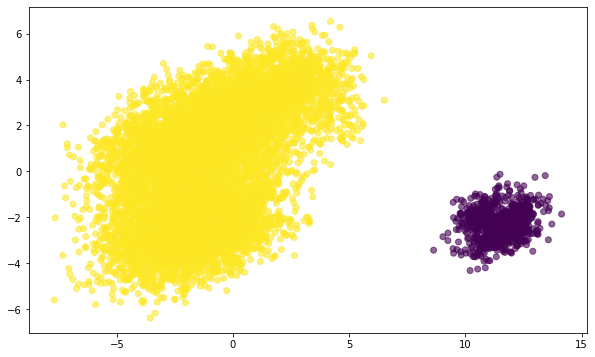

In [39]:
fig, ax = plt.subplots(figsize=(10, 6))
Y = linkage(X_new_svd, method='complete')
cluster_labels = fcluster(Y, t=19, criterion='distance')
plt.scatter(X_new_svd[:, 0], X_new_svd[:, 1], c=cluster_labels, alpha=0.6);

<span style="font-size: 18px">
    <b>Average Linkage</b>
</span>

Average linkage is another hierarchical clustering criterion where their similarity between two clusters is determined by taking the average distance between all points in one cluster to all points in another cluster. We can say that this method is a compromise between single linkage and complete linkage.

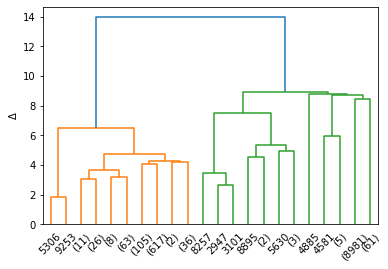

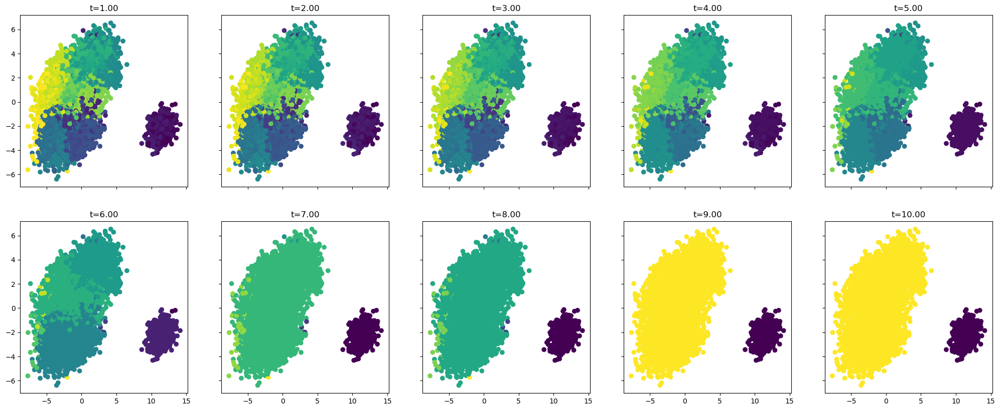

In [40]:
# Average
Y = linkage(X_new_svd, method='average')

plot1(Y);

cost = np.arange(1, 11, 1)
fig, ax = plt.subplots(2, len(cost)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))
for index, t in enumerate(cost):
    y_predict_soccer = fcluster(Y, t=t, criterion='distance')
    if index < (len(cost)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1],
                             c=y_predict_soccer)
        ax[0][index].set_title(f't={t:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1],
                                          c=y_predict_soccer)
        ax[1][index-len(cost)//2].set_title(f't={t:.2f}')

Performing a grid search for the optimal hyperparameter, we get

100%|██████████| 15/15 [00:38<00:00,  2.56s/it]


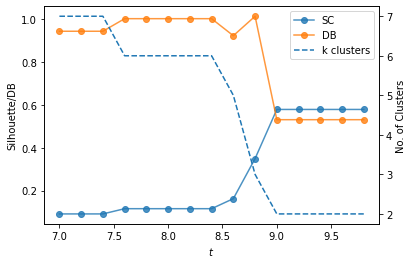

In [41]:
epss = np.arange(7, 10, 0.2)

fig, ax = plt.subplots()
ax2 = ax.twinx()

SH = []
DB = []
CH = []
Y = linkage(X_new_svd, method='average')
for index, eps in enumerate(tqdm(epss)):
    cluster_labels = fcluster(Y, t=eps, criterion='distance')
    SH.append(silhouette_score(X_new_svd, cluster_labels))
    DB.append(davies_bouldin_score(X_new_svd, cluster_labels))
    CH.append(cluster_labels.max())
ax.plot(epss, SH, '-o', label=f'SC', alpha=0.8)
ax.plot(epss, DB, '-o', label=f'DB', alpha=0.8)
ax2.plot(epss, CH, '--', label=f'k clusters')
ax.set_xlabel(r'$t$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

The internal validation criteria shows us that:
* **SC**: The silhouette coefficient is closest to 0.5 at t=9.6. This value suggests an optimal number of clusters of k=2.
* **DB**: The DB index is also closest to zero at t=9.6. This result agrees with our conclusion from the silhouette coefficient that the optimal number of clusters is k=2.

With the optimal hyperparameter, we get the final clustering

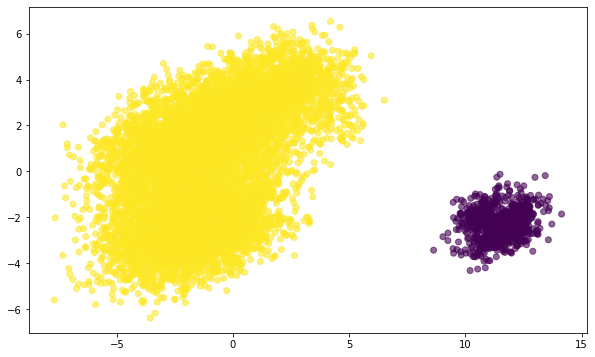

In [42]:
fig, ax = plt.subplots(figsize=(10, 6))
Y = linkage(X_new_svd, method='average')
cluster_labels = fcluster(Y, t=9.6, criterion='distance')
plt.scatter(X_new_svd[:, 0], X_new_svd[:, 1], c=cluster_labels, alpha=0.6);

<span style="font-size: 18px">
    <b>Ward's Linkage</b>
</span>

Ward's linkage is another hierarchical clustering criterion where the similrity between two clusters is determined by considering the change in variance. Two clusters that result in the smallest change in variance is combined into a new cluster, untill all points belong to the same cluster or a stopping condition is met.

One of the advantages of the Ward's linkage is that it attempts to balance out the clusters as much as possible.

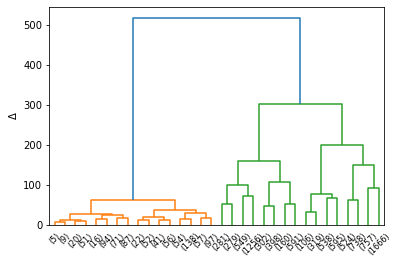

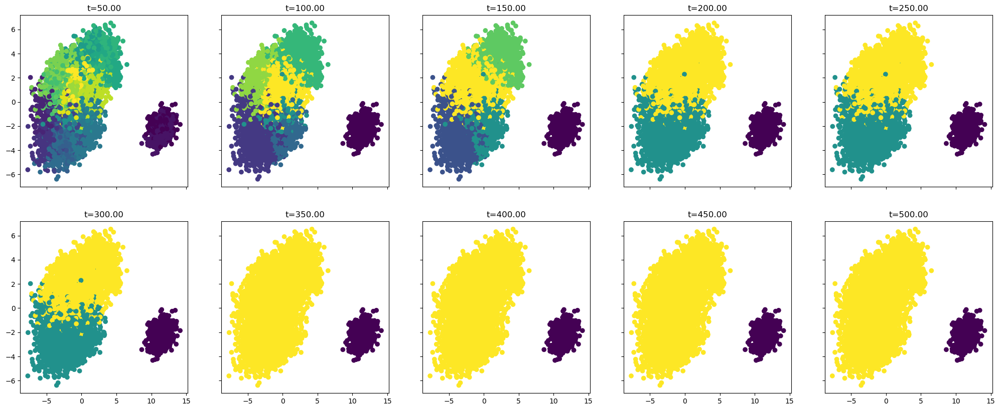

In [43]:
# Ward
Y = linkage(X_new_svd, method='ward')

plot1(Y);

cost = np.arange(50, 550, 50)
fig, ax = plt.subplots(2, len(cost)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))
for index, t in enumerate(cost):
    y_predict_soccer = fcluster(Y, t=t, criterion='distance')
    if index < (len(cost)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1],
                             c=y_predict_soccer)
        ax[0][index].set_title(f't={t:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1],
                                          c=y_predict_soccer)
        ax[1][index-len(cost)//2].set_title(f't={t:.2f}')

Again, we performed grid search for the optimal hyperparameter

100%|██████████| 13/13 [00:29<00:00,  2.27s/it]


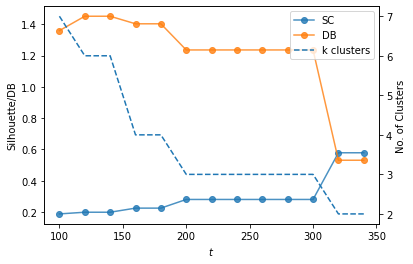

In [44]:
epss = np.arange(100, 360, 20)

fig, ax = plt.subplots()
ax2 = ax.twinx()

SH = []
DB = []
CH = []
Y = linkage(X_new_svd, method='ward')
for index, eps in enumerate(tqdm(epss)):
    cluster_labels = fcluster(Y, t=eps, criterion='distance')
    SH.append(silhouette_score(X_new_svd, cluster_labels))
    DB.append(davies_bouldin_score(X_new_svd, cluster_labels))
    CH.append(cluster_labels.max())
ax.plot(epss, SH, '-o', label=f'SC', alpha=0.8)
ax.plot(epss, DB, '-o', label=f'DB', alpha=0.8)
ax2.plot(epss, CH, '--', label=f'k clusters')
ax.set_xlabel(r'$t$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

The internal validation criteria shows us that:
* **SC**: The silhouette coefficient is closest to 0.5 at t=300. This value suggests an optimal number of clusters of k=2.
* **DB**: The DB index is also closest to zero at t=300. This result agrees with our conclusion from the silhouette coefficient that the optimal number of clusters is k=2.

The final clustering for this set of hyperparameters is:

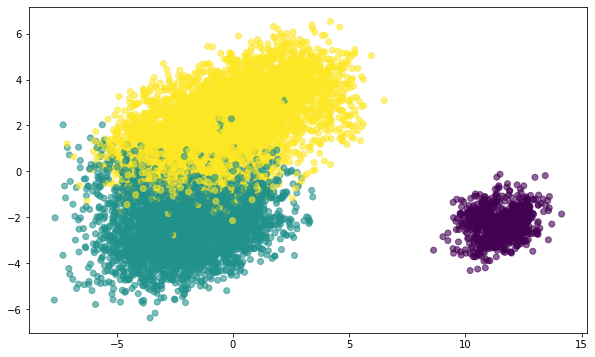

In [45]:
fig, ax = plt.subplots(figsize=(10, 6))
Y = linkage(X_new_svd, method='ward')
cluster_labels = fcluster(Y, t=300, criterion='distance')
plt.scatter(X_new_svd[:, 0], X_new_svd[:, 1], c=cluster_labels, alpha=0.6);

We can see, from the grid-search implementation of the various hierarchical clustering criterion, the difference in how these various algorithms attempt to cluster the dataset. Let us summarize:

* **Single Linkage** - Optimal k value is k=2 or k=3
* **Complete Linkage** - Optimal k value is k=2
* **Average Linkage** - Optimal k value is k=2
* **Ward Linkage** - Optimal k value is k=2

All of the four (4) techniques gave out the supports the conclusion that the optimal value for k is k=2. 

On a side note, notice how Ward's linkage attempts to balance out the clusters well before ultimately reaching 2 clusters.

<h2 style="color:#000000">Density-Based Clustering</h2>

Density-based clustering is another clustering method where it groups together densely populated areas of the dataset and at the same time separates sparsely populated regions. Unlike other clustering techniques where the metric for cluster determination is a distance measure, density-based clustering uses a scan radius and the minimum number of samples in a neighborhood or min_samples These are referred to as epsilon and min_samples, respectively.

There are various types of density-based clustering, however, we will limit the scope of this project by only utilizing the two most popular among the group:
- Density-Based Spatial Clustering of Applications with Noise (DBSCAN)
- Ordering Points To Identify the Clustering Structure (OPTICS)

<span style="font-size: 18px">
    <b>DBSCAN</b>
</span>

Density-Based Spatial Clustering of Applications with Noise or DBSCAN is a density-based clustering algorithm that groups together points in the dataset that are close to each other based on a distance metric or the search radius and the minimum number of points required to form a cluster.

The algorithm identifies neighborhoods or clusters which contain core points and border points. A core point is the center of the neighborhood, where it has at least a minimum number of points within its search radius epsilon. Points that are not identified by any neighborhood are called noise points.

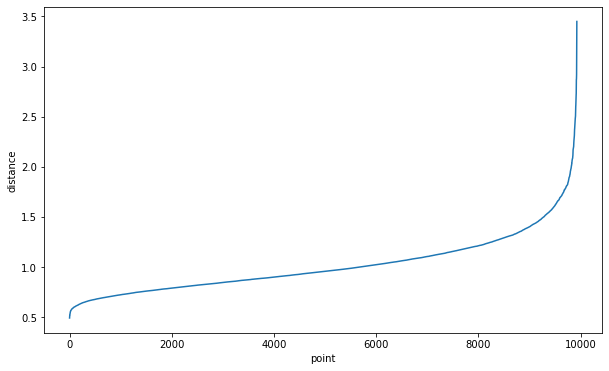

In [46]:
fig, ax = plt.subplots(figsize=(10, 6))
plt.plot(ave_nn_dist(5, X_new_svd))
plt.xlabel('point')
plt.ylabel('distance');

Initially, we set the minimum number of points at min_pts=50 and check whether this is good enough to identify our cluster. We then perform a grid search over different values of epsilon which covers the entire plot.

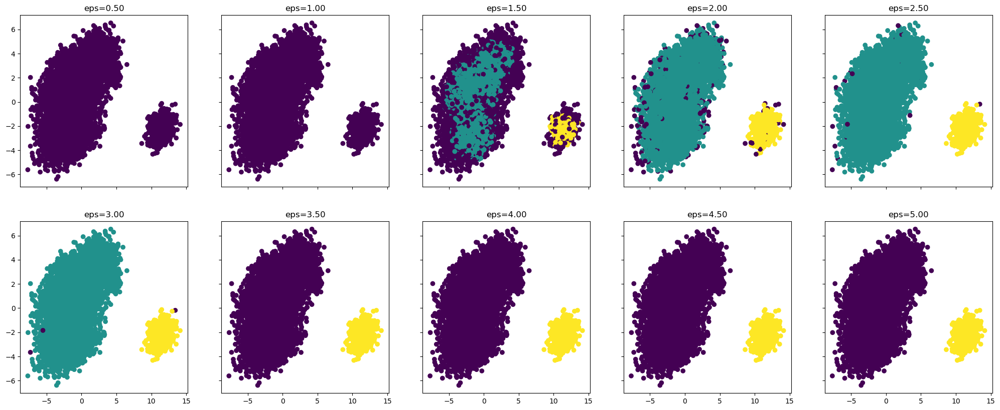

In [47]:
epss = np.arange(0.5, 5.5, 0.5)
min_pts = 50
dbcvs = []
fig, ax = plt.subplots(2, len(epss)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))
for index, eps in enumerate(epss):
    dbscan = DBSCAN(eps=eps, min_samples=min_pts)
    cluster_labels = dbscan.fit_predict(X_new_svd)
    if index < (len(epss)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels)
        ax[0][index].set_title(f'eps={eps:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels)
        ax[1][index-len(cost)//2].set_title(f'eps={eps:.2f}')

We also look at the internal validation critera for density-based clustering methods. The internal validation criteria for DBSACAN is given by:

100%|██████████| 4/4 [04:29<00:00, 67.42s/it]


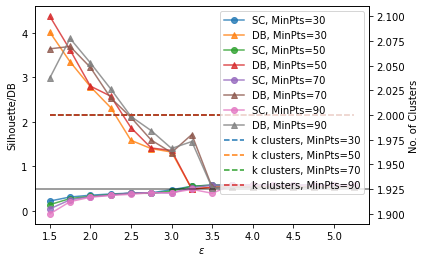

In [48]:
epss = np.arange(1.5, 5.5, 0.25)
min_ptss = np.arange(30, 100, 20)

fig, ax = plt.subplots()
ax2 = ax.twinx()
for index_mp, min_pts in enumerate(tqdm(min_ptss)):
    SS_mp = []
    CH_mp = []
    DB_mp = []
    for index, eps in enumerate(epss):
        dbscan = DBSCAN(eps=eps, min_samples=min_pts)
        cluster_labels = dbscan.fit_predict(X_new_svd)
        SS_mp.append(silhouette_score(X_new_svd, cluster_labels))
        CH_mp.append(cluster_labels.max()+1)
        DB_mp.append(davies_bouldin_score(X_new_svd, cluster_labels))
    ax.plot(epss, SS_mp, '-o', label=f'SC, MinPts={min_pts}', alpha=0.8)
    ax.plot(epss, DB_mp, '-^', label=f'DB, MinPts={min_pts}', alpha=0.8)
    ax2.plot(epss, CH_mp, '--', label=f'k clusters, MinPts={min_pts}')
ax.axhline(0.5, color='black', alpha=0.5)
ax.set_xlabel(r'$\epsilon$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

Notice that based on the sample clustering and the plot above, DBSCAN can only identify k=2 clusters for our chosen range of parameters. In identifying the optimal hyperparameter:
* **SC** - For all values of MinPts, we get a value of 0.5 at $\epsilon$ = 3.25. The difference in silhouette coefficient between the range of MinPts appears to be negligible.
* **DB** - We get the minimum DB at MinPts=30 and MinPts=50 at $\epsilon$ = 3.25.

For our final clustering, we go with MinPts=50 at $\epsilon$ = 3.25. Same with the earlier clustering methods, the optimal number of clusters appears to be at k=2.

Number of clusters: 2
Number of noise points: 1
Number of points: 9929
Silhouette score: 0.55280127729256


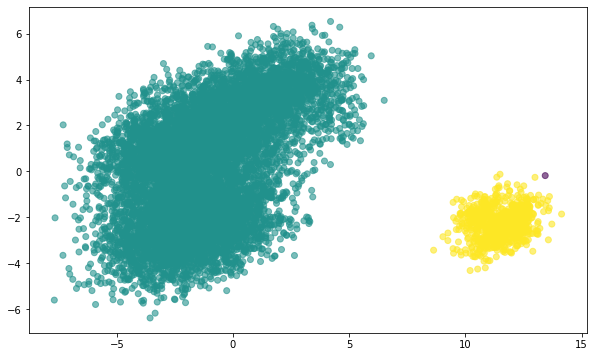

In [49]:
fig, ax = plt.subplots(figsize=(10, 6))
dbscan = DBSCAN(eps=3.25, min_samples=50)
cluster_labels = dbscan.fit_predict(X_new_svd)
plt.scatter(X_new_svd[:, 0], X_new_svd[:, 1], c=cluster_labels, alpha=0.6)
print('Number of clusters:', cluster_labels.max()+1)
print('Number of noise points:', (cluster_labels==-1).sum())
print('Number of points:', len(cluster_labels))
print('Silhouette score:', silhouette_score(X_new_svd, cluster_labels))

Based on our grid-search implementation on top of DBSCAN, good quality clusters are formed around $\epsilon$ = 3.25 onwards.

The DBSCAN algorithm identified that at the specified parameters, the best value for k is k=2. Also, notice how there is only one noise point. We also obtained a silhouette score of 0.55 which is near the ideal value of 0.50.

<span style="font-size: 18px">
    <b>OPTICS</b>
</span>

Ordering Points To Identify the Clustering Structure or OPTICS is another type of density-based clustering technique. It is similar to DBSCAN, however, the main difference is that OPTICS handles the clusters of varying densities by creating an order of the data points based on their densities.

OPTICS uses reachability as a distance metric which is just the distance to the nearest dense region. This is particularly helpful especially if we want to identify clusters of arbitrary shapes. The downside to OPTICS is that the algorithm is computationally expensive and its complexity grows exponentially as the dataset becomes increasingly larger.

One advantage of optics is that we can use the reachability plot to identify our reachability cutoff to arrive at our desired number of clusters or k value.

100%|██████████| 4/4 [00:39<00:00,  9.98s/it]


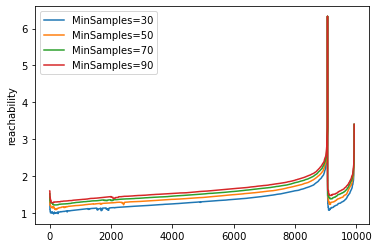

In [50]:
for ms in tqdm(np.arange(30, 100, 20)):
    optics = OPTICS(min_samples=ms)
    optics.fit(X_new_svd)
    plt.plot(optics.reachability_[optics.ordering_], label=f'MinSamples={ms}')
    plt.ylabel('reachability')
    plt.legend(loc='best');

From the reachability plot above, we can already tell that a value of 3.50 and above for reachability will result in two main clusters. The effect of changing the MinSamples on the reachability plot also appears to be negligible. So for our hyperparameter tuning, we only show the case for when MinPts=50.

In [51]:
optics = OPTICS(min_samples=50)
optics.fit(X_new_svd)

OPTICS(min_samples=50)

100%|██████████| 10/10 [00:00<00:00, 202.61it/s]


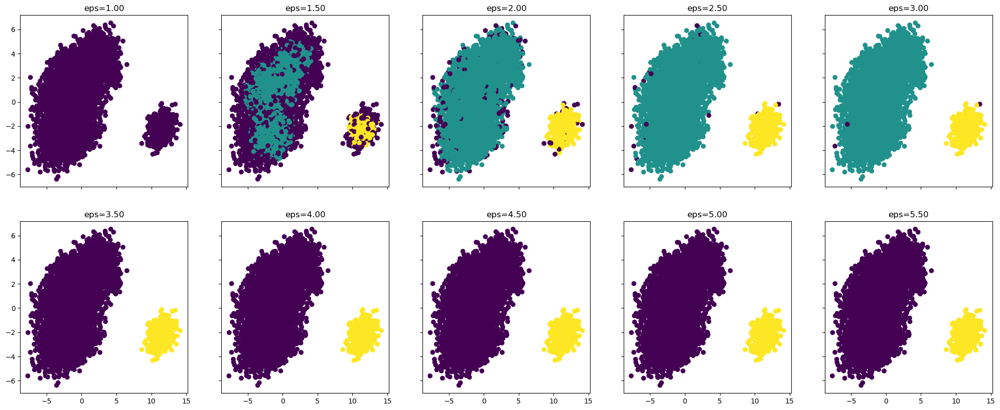

In [52]:
epss = np.arange(1, 6, 0.5)
fig, ax = plt.subplots(2, len(epss)//2, dpi=100, sharex=True, sharey=True, 
                           figsize=(25,10))

for index, eps in enumerate(tqdm(epss)):
    cluster_labels = cluster_optics_dbscan(
                        reachability=optics.reachability_,
                        core_distances=optics.core_distances_,
                        ordering=optics.ordering_,
                        eps=eps
                        )
    if index < (len(epss)//2):
        ax[0][index].scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels)
        ax[0][index].set_title(f'eps={eps:.2f}')
    else:
        ax[1][index-len(cost)//2].scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels)
        ax[1][index-len(cost)//2].set_title(f'eps={eps:.2f}')

To back our earlier claim, we used a grid-search implementation on top of OPTICS to identify the optimal values for the hyperparameter eps if we set our minimum number of samples to min_samples=50.

100%|██████████| 10/10 [00:22<00:00,  2.30s/it]


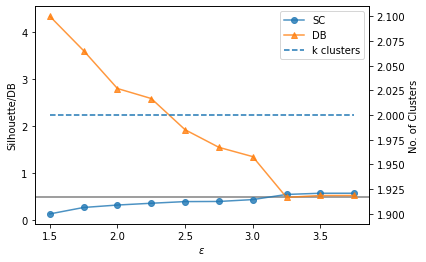

In [53]:
epss = np.arange(1.5, 4, 0.25)

fig, ax = plt.subplots()
ax2 = ax.twinx()

SH = []
DB = []
CH = []
for index, eps in enumerate(tqdm(epss)):
    cluster_labels = cluster_optics_dbscan(
                        reachability=optics.reachability_,
                        core_distances=optics.core_distances_,
                        ordering=optics.ordering_,
                        eps=eps
                        )
    SH.append(silhouette_score(X_new_svd, cluster_labels))
    DB.append(davies_bouldin_score(X_new_svd, cluster_labels))
    CH.append(cluster_labels.max()+1)
ax.axhline(0.5, color='black', alpha=0.5)
ax.plot(epss, SH, '-o', label=f'SC', alpha=0.8)
ax.plot(epss, DB, '-^', label=f'DB', alpha=0.8)
ax2.plot(epss, CH, '--', label=f'k clusters')
ax.set_xlabel(r'$\epsilon$')
ax.set_ylabel('Silhouette/DB')
lines, labels = ax.get_legend_handles_labels()
ax2.set_ylabel('No. of Clusters')
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines+lines2, labels+labels2, loc='upper right');

Similar to DBSCAN, OPTICS can only identify k=2 clusters for our chosen range of parameters. In identifying the optimal hyperparameter:
* **SC** - Silhouette coefficient is closest to 0.5 at around $\epsilon$ = 3.0 or $\epsilon$ = 3.25.
* **DB** - We get the minimum DB at $\epsilon$ = 3.25.

For our final clustering, we decided to go with $\epsilon$ = 3.25. Same with the earlier clustering methods, the optimal number of clusters appears to be at k=2.

Number of clusters: 2
Number of noise points: 1
Number of points: 9929
Silhouette score: 0.55280127729256


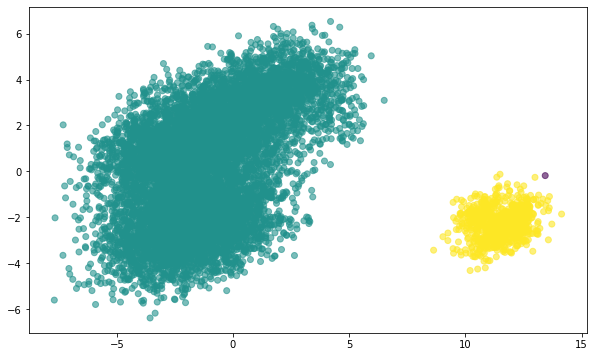

In [54]:
cluster_labels = cluster_optics_dbscan(
    reachability=optics.reachability_,
    core_distances=optics.core_distances_,
    ordering=optics.ordering_,
    eps=3.25
)
fig, ax = plt.subplots(figsize=(10, 6))
plt.scatter(X_new_svd[:,0], X_new_svd[:,1], c=cluster_labels, alpha=0.6);
print('Number of clusters:', cluster_labels.max()+1)
print('Number of noise points:', (cluster_labels==-1).sum())
print('Number of points:', len(cluster_labels))
print('Silhouette score:', silhouette_score(X_new_svd, cluster_labels))

To no surprise, we obtained the same results as we did from our implementation of DBSCAN. We obtained the same number of clusters, the same number of noise points, and the same silhouette score. The best value, in this case, is also k=2.

<h2 style="color:#000000">Clustering by Overall Rating Groups</h2>

We will now test how clusters are formed by cluster over different groups. We classified them as low, mid, and high. We will only be performing kmeans clustering to check whether we can interpret clusters formed by binning players based on overall rating.

Low - Below 70 (50 percent of all players belong in this bin)
- These are player who get little to no playing time at all.

Mid - 70 to 83
- These are your average professional players. Most role players belong in these category.

High - 84 and Above
- These are players who are star and superstar material. 

<span style="font-size: 18px">
    <b>Clustering the low tier players</b>
</span>

First, let's apply a grid-search implementation on top of K-means clustering to the low-tier players dataset. The plot should give us an overview of how the players are being clustered based on the available features.

100%|██████████| 8/8 [00:16<00:00,  2.09s/it]


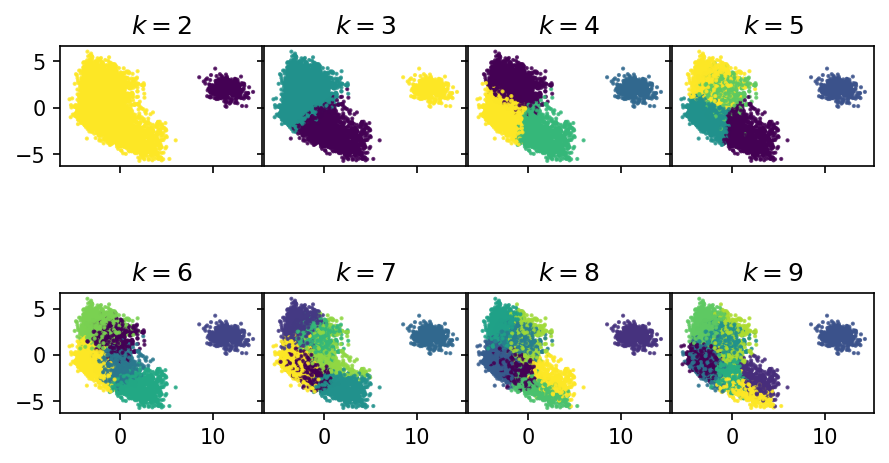

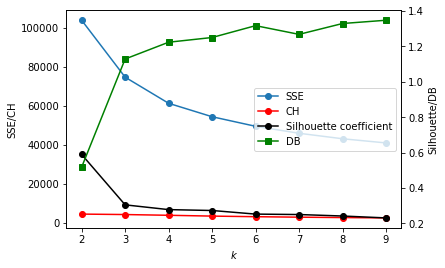

In [55]:
# Filtering out the dataset
df_low = df_soccer.loc[(df_soccer['overall_rating'] < 70)]

# Separating the values from categorical features
player_names_low = df_low['player_name']
player_id_low = df_low['player_fifa_api_id']
X_soccer_unscaled_low = df_low.drop(['player_fifa_api_id', 'date', 'player_name'], axis=1)

# Scaling Dataset
standard_scaler = StandardScaler()
X_soccer_low = standard_scaler.fit_transform(X_soccer_unscaled_low)

# Current Working Dataset

svd = TruncatedSVD(n_components=6, random_state=1337)
X_new_svd_low = svd.fit_transform(X_soccer_low)
# fig, ax = plt.subplots(figsize=(10, 10))
# plt.scatter(X_new_svd_low[:,0], X_new_svd_low[:,1]);

# KMeans

res_low = cluster_range(X_new_svd_low, KMeans(random_state=1337), 2, 9)
plot_clusters(X_new_svd_low, res_low['ys'], res_low['centers']);

plot_internal(res_low['inertias'], res_low['chs'], res_low['scs'],
              res_low['dbs']);

Let us summarize the results:
    
* **Visual**: Looking at the plot, it seems that k=2, k=3, k=4, and k=5 look the most visually appealing.
* **SSE**: For SSE, we want to use the elbow method to identify the best value for k. According to the elbow method, the best value for k is k=3
* **CH**: For the CH index, we cannot judge the largest value based on the plot alone. However, after taking the values, k=2 is the best.
* **SC**: For the Silhouette coefficient, the heuristic is to get a value that is closest to 0.5 in the plot above, we can see that it is k=2
* **DB**: For the DB index, we want a value that is close to zero but not 0. The plot above shows us that k=2 is the closest value to zero, hence the best value for k.

Based on the internal validation scores alone, we can already tell that the best value for k is k=2.

<span style="font-size: 18px">
    <b>Clustering the mid tier players</b>
</span>

Moving on to the mid-tier players, let's check whether we get the same clustering as the previous one for low-tier players.

100%|██████████| 8/8 [00:11<00:00,  1.44s/it]


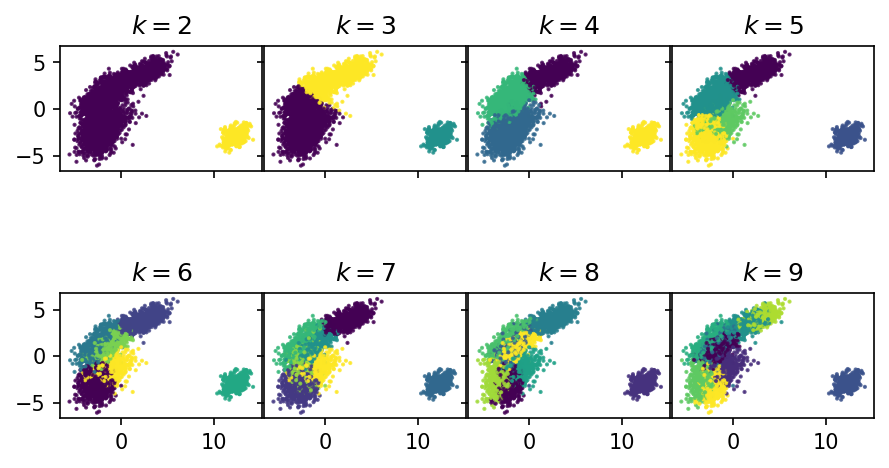

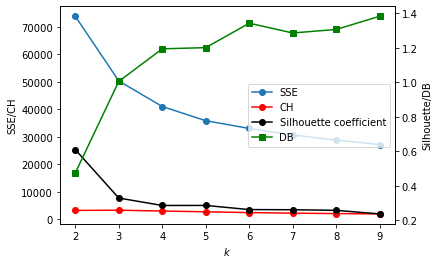

In [56]:
# Filtering out the dataset
df_mid = df_soccer.loc[(df_soccer['overall_rating'] >= 70) & (df_soccer['overall_rating'] < 84)]

# Separating the values from categorical features
player_names_mid = df_mid['player_name']
player_id_mid = df_mid['player_fifa_api_id']
X_soccer_unscaled_mid = df_mid.drop(['player_fifa_api_id', 'date', 'player_name'], axis=1)

# Scaling Dataset
standard_scaler = StandardScaler()
X_soccer_mid = standard_scaler.fit_transform(X_soccer_unscaled_mid)

# Current Working Dataset

svd = TruncatedSVD(n_components=6, random_state=1337)
X_new_svd_mid = svd.fit_transform(X_soccer_mid)
# fig, ax = plt.subplots(figsize=(10, 10))
# plt.scatter(X_new_svd_low[:,0], X_new_svd_low[:,1]);

# KMeans

res_mid = cluster_range(X_new_svd_mid, KMeans(random_state=1337), 2, 9)
plot_clusters(X_new_svd_mid, res_mid['ys'], res_mid['centers']);

plot_internal(res_mid['inertias'], res_mid['chs'], res_mid['scs'],
              res_mid['dbs']);

Let us summarize the results:
    
* **Visual**: Looking at the plot, it seems that k=2, k=3, and k=4 look the most visually appealing.
* **SSE**: For SSE, we want to use the elbow method to identify the best value for k. According to the elbow method, the best value for k is k=3
* **CH**: For the CH index, we cannot judge the largest value based on the plot alone. However, after taking the values, k=2 is the best.
* **SC**: For the Silhouette coefficient, the heuristic is to get a value that is closest to 0.5 in the plot above, we can see that it is k=2
* **DB**: For the DB index, we want a value that is close to zero but not 0. The plot above shows us that k=2 is the closest value to zero, hence the best value for k.

Based on the internal validation scores alone, we can already tell that the best value for k is k=2.
At the onset, it looks like we obtained the same results as the previous attempt.

<span style="font-size: 18px">
    <b>Clustering the high tier players</b>
</span>

Since this is somewhat of an experiment, we also apply the same methodology to the high-tier players. Let's check. Would we get the same results this time?

100%|██████████| 8/8 [00:01<00:00,  5.50it/s]


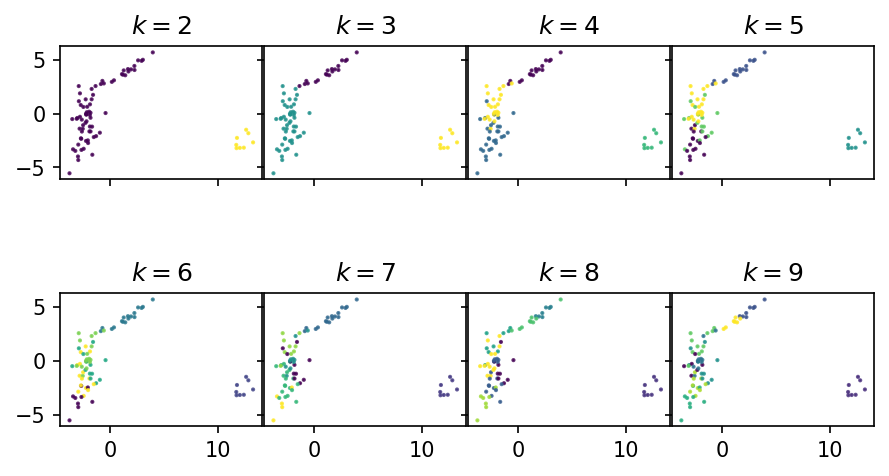

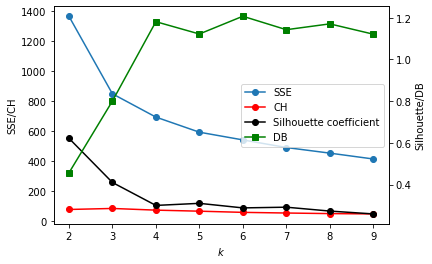

In [57]:
# Filtering out the dataset
df_high = df_soccer.loc[(df_soccer['overall_rating'] >= 84)]

# Separating the values from categorical features
player_names_high = df_high['player_name']
player_id_high = df_high['player_fifa_api_id']
X_soccer_unscaled_high = df_high.drop(['player_fifa_api_id', 'date', 'player_name'], axis=1)

# Scaling Dataset
standard_scaler = StandardScaler()
X_soccer_high = standard_scaler.fit_transform(X_soccer_unscaled_high)

# Current Working Dataset

svd = TruncatedSVD(n_components=6, random_state=1337)
X_new_svd_high = svd.fit_transform(X_soccer_high)
# fig, ax = plt.subplots(figsize=(10, 10))
# plt.scatter(X_new_svd_low[:,0], X_new_svd_low[:,1]);

# KMeans

res_high = cluster_range(X_new_svd_high, KMeans(random_state=1337), 2, 9)
plot_clusters(X_new_svd_high, res_high['ys'], res_high['centers']);

plot_internal(res_high['inertias'], res_high['chs'], res_high['scs'],
              res_high['dbs']);

Let us summarize the results:
    
* **Visual**: Looking at the plot, it seems that k=2, k=3, and k=4 look the most visually appealing.
* **SSE**: For SSE, we want to use the elbow method to identify the best value for k. According to the elbow method, the best value for k is k=3
* **CH**: For the CH index, we cannot judge the largest value based on the plot alone. However, after taking the values, k=2 is the best.
* **SC**: For the Silhouette coefficient, the heuristic is to get a value that is closest to 0.5 in the plot above, we can see that it is k=2
* **DB**: For the DB index, we want a value that is close to zero but not 0. The plot above shows us that k=2 is the closest value to zero, hence the best value for k.

Based on the internal validation scores alone, we can already tell that the best value for k is k=2.
We also obtained the same result as the implementation on the low-tier and mid-tier players.

However, let's explore the high-tier players a bit more. 

<span style="font-size: 18px">
    <b>Is there a meaning to the clusters formed at k=4?</b>
</span>

From the results, it was obvious that the best value for k is k=2. This probably means something, but let's explore the granularity of the subject matter. What if we try k=4? Will the algorithm identify the players based on their natural field positions?

We know from soccer that we can classify players based on four (4) main positions:

1. **Forward** - These players are the strikers. They are the players who create offense for the team by making plays and scoring goals. These players are excellent at dribbling, shooting, and finishing. They are also exceptionally quick and agile.

2. **Mid-Fielder** - These players play on the central area of the football field. These players are often involved in both the offensive and defensive plays of the game. They are responsible for controlling the flow of the game. These players have fairly balanced stats and also excel in passing and dribbling. Players in this position should have exceptional endurance and mobility to be effective in their role.

3. **Defender** - These players play near their own goal intending to prevent the opposing team from scoring. They are often called the last line of defense before the goalkeeper. These players excel in aerial ability, and tackling skills, and are often backed by their impressive physical ability.

4. **Goalkeeper** - These players play in the goal area of the field and their primary objective is to defend the goal from the opposing team by blocking shots and making saves. They are the only players who are allowed to use their hands in the game of soccer.

Let us perform K-means clustering at k=4 on the high-tier players. We have four decently separated clusters. But who are these players anyway? Let's find out!

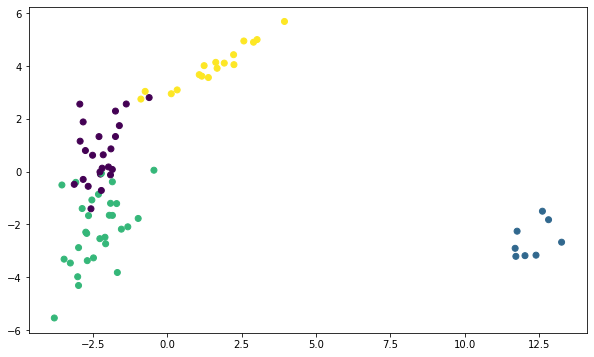

In [58]:
# k=2
fig, ax = plt.subplots(figsize=(10, 6))
k_means = KMeans(4, random_state=214).fit(X_new_svd_high)
labels = k_means.predict(X_new_svd_high)
centroid = k_means.cluster_centers_
clusters = k_means.labels_.tolist()
plt.scatter(X_new_svd_high[:,0], X_new_svd_high[:,1], c=labels);

Let's try plotting it differently with the use of seaborn. At the same time, let's add the names of these players beside the data points. At the onset, we can already see familiar names such as Lionel Messi and Neymar. Hopwever, some of the names are clumped up and cannot be clearly seen. How about looking at the datapoints per cluster.

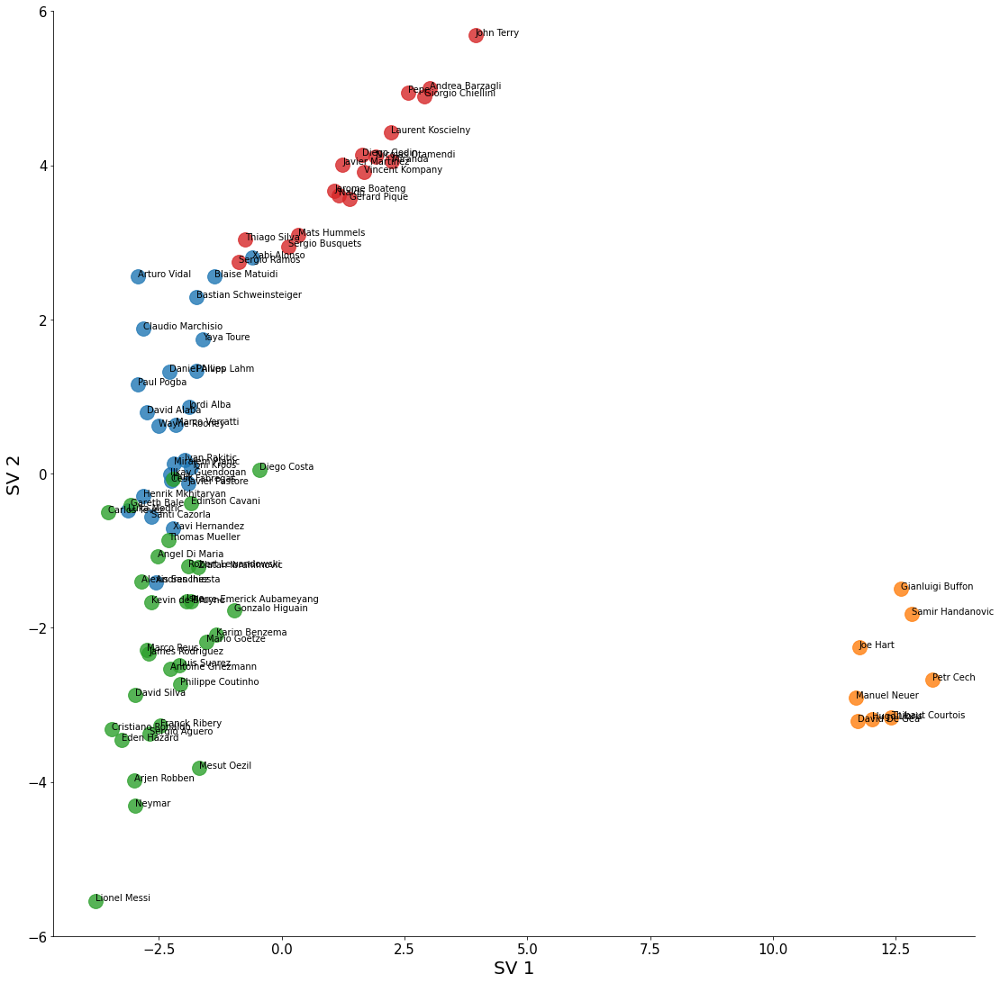

In [59]:
reduced = pd.DataFrame(X_new_svd_high[:, :2])
reduced['cluster'] = clusters
reduced['name'] = player_names_high.values
reduced.columns = ['x', 'y', 'cluster', 'name']

%matplotlib inline
# sns.set(style="white")
ax = sns.lmplot(x="x", y="y", hue='cluster', data = reduced, legend=False,
fit_reg=False, size = 15, scatter_kws={"s": 250})
texts = []
for x, y, s in zip(reduced.x, reduced.y, reduced.name):
    texts.append(plt.text(x, y, s, fontstretch='ultra-expanded'))
ax.set(ylim=(-6, 6))
plt.tick_params(labelsize=15)
plt.xlabel("SV 1", fontsize = 20)
plt.ylabel("SV 2", fontsize = 20)
plt.show();

Let's start with cluster 0. Are you familiar with the names of these pro players? You most probably aren't as these players, although highly exceptional, might not have global recognition, especially in countries where the sport is not as prominent. Waver not however, google is our friend. Let us sample five (5) of these players and determine what their positions are.

1. Luka Modric - Midfielder
2. Blaise Matuidi - Midfielder
3. Xabi Alonso - Midfielder
4. Santi Cazorla - Midfielder
5. Arturo Vidal - Midfielder

Amazingly, it seems that this cluster is composed of midfielders. These are the players who play in the central part of the field. They control the flow of the game and are involved in both offense and defense. However, we can't be so sure yet, let's check the next cluster which is cluster 1.

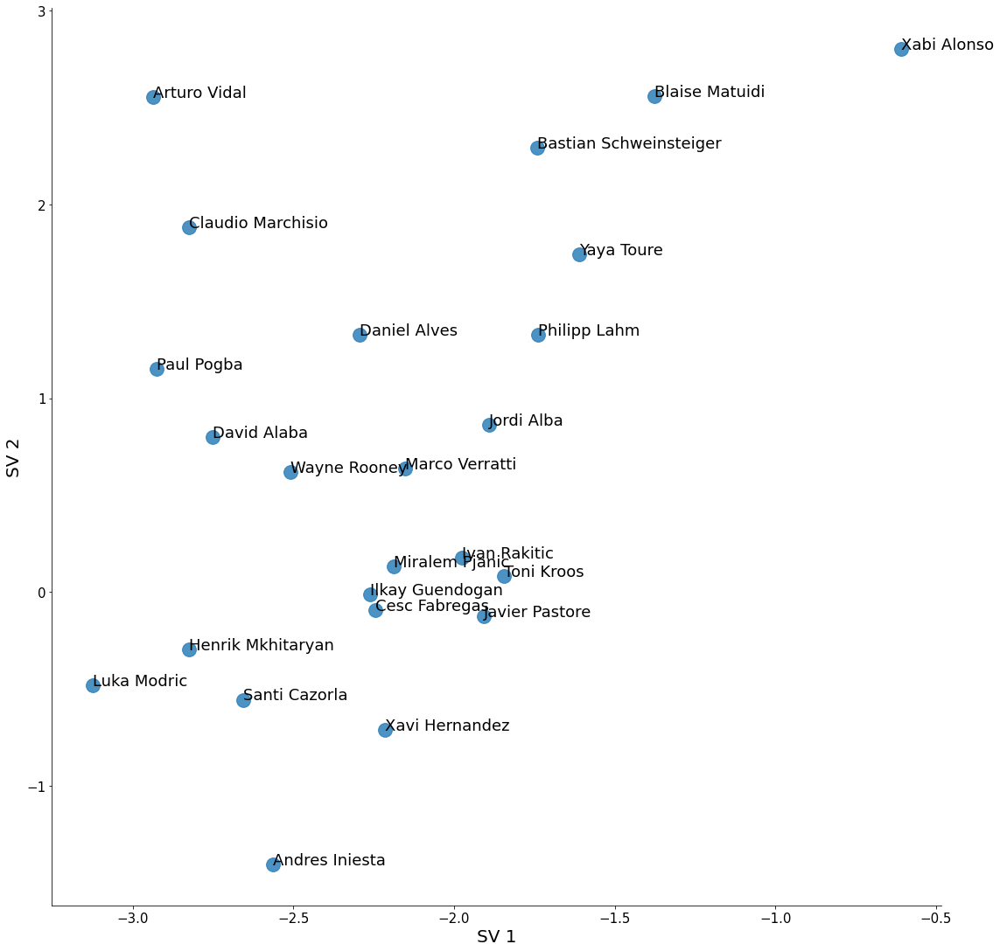

In [60]:
clust_0 = reduced.loc[reduced['cluster'] == 0]
%matplotlib inline
# sns.set(style="white")
ax = sns.lmplot(x="x", y="y", hue='cluster', data = clust_0, legend=False,
fit_reg=False, size = 15, scatter_kws={"s": 250})
texts = []
for x, y, s in zip(clust_0.x, clust_0.y, clust_0.name):
    texts.append(plt.text(x, y, s, fontstretch='ultra-expanded', fontsize='18'))
# ax.set(ylim=(-6, 6))
plt.tick_params(labelsize=15)
plt.xlabel("SV 1", fontsize = 20)
plt.ylabel("SV 2", fontsize = 20)
plt.show();

Again, let's sample five (5) players from this cluster.

1. Gianluigi Buffon - Goalkeeper
2. Joe Hart - Goalkeeper
3. Hugo Lloris - Goalkeeper
4. David De Gea - Goalkeeper
5. Petr Cech - Goalkeeper

From cluster 1, we have identified players which are goalkeepers. Did we expect this? Yes, as this cluster is the one located at the lower right of the entire dataset, which forms the smaller cluster.
Goalkeeper stats are somewhat of an outlier. They excel in goalkeeper stats but have relatively low stats everywhere else.

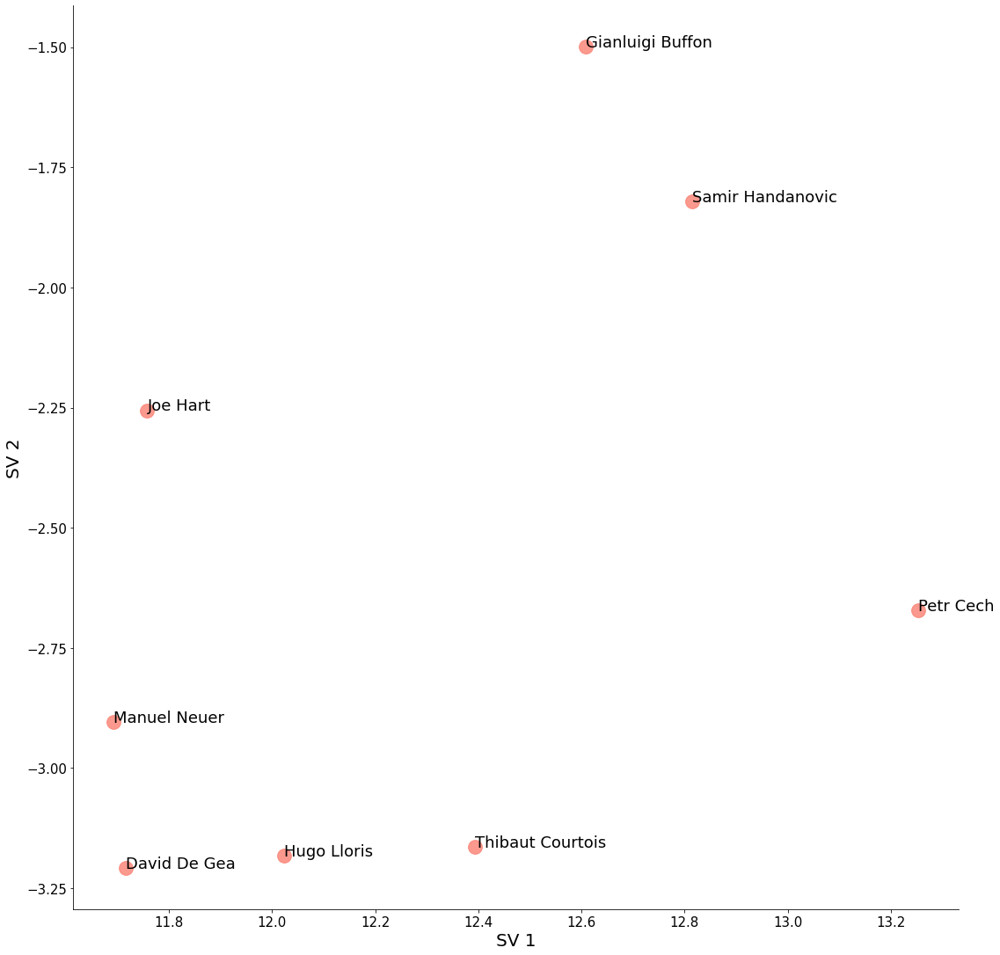

In [61]:
clust_1 = reduced.loc[reduced['cluster'] == 1]
%matplotlib inline
# sns.set(style="white")
ax = sns.lmplot(x="x", y="y", palette= 'dark:salmon_r', hue='cluster', data = clust_1, legend=False,
fit_reg=False, size = 15, scatter_kws={"s": 250})
texts = []
for x, y, s in zip(clust_1.x, clust_1.y, clust_1.name):
    texts.append(plt.text(x, y, s, fontstretch='ultra-expanded', fontsize='18'))
# ax.set(ylim=(-6, 6))
plt.tick_params(labelsize=15)
plt.xlabel("SV 1", fontsize = 20)
plt.ylabel("SV 2", fontsize = 20)
plt.show();

So far, we are already seeing a pattern between clusters. This is good news. Now, moving on to Cluster 2, we will again sample five (5) players from this cluster.

1. John Terry - Defender/Centre-back
2. Javier Martinez - Defensive Midfielder/Central Defender
3. Thiago Silva - Defender/Centre-back
4. Vincent Kompany - Defender/Centre-back
5. Mats Hummels - Defender/Centre-back

Cluster 2 is primarily composed of defenders. These are the players assigned in defending the goal but aren't allowed to use their hands. They prevent players from the opposing team from scoring a goal.

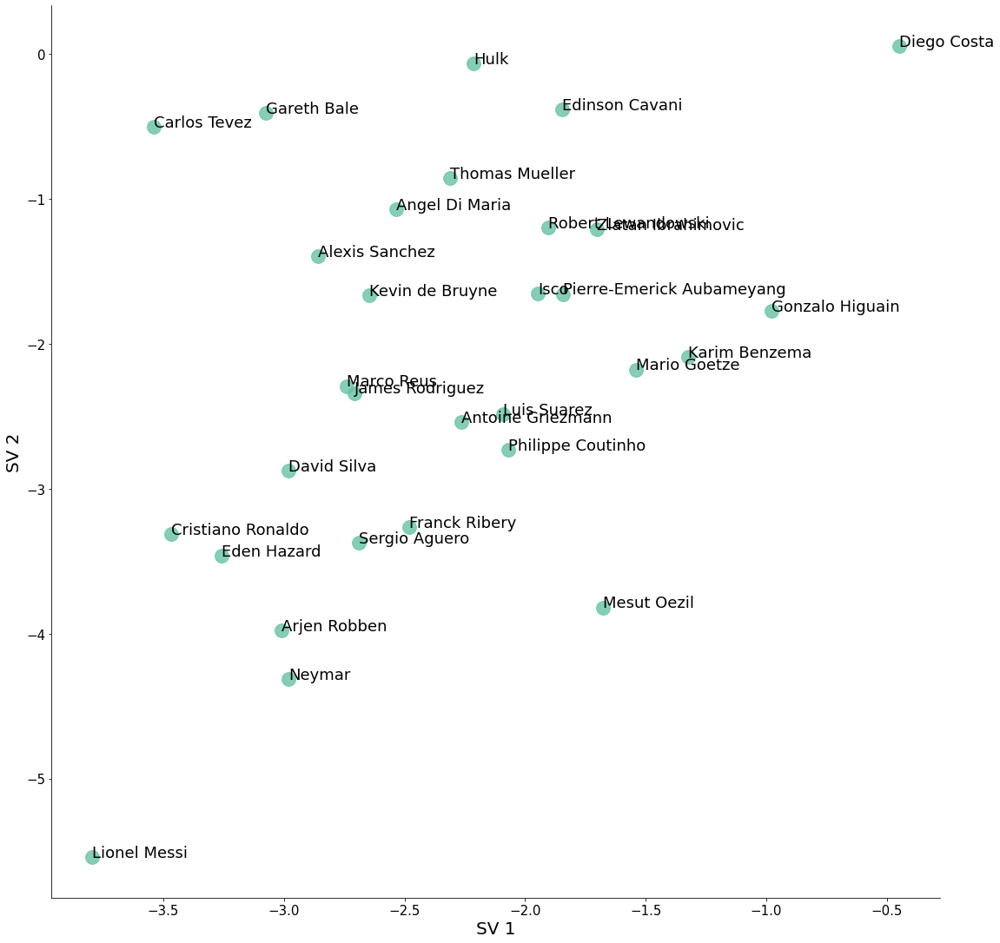

In [62]:
clust_2 = reduced.loc[reduced['cluster'] == 2]
%matplotlib inline
# sns.set(style="white")
ax = sns.lmplot(x="x", y="y", palette= 'Set2', hue='cluster', data = clust_2, legend=False,
fit_reg=False, size = 15, scatter_kws={"s": 250})
texts = []
for x, y, s in zip(clust_2.x, clust_2.y, clust_2.name):
    texts.append(plt.text(x, y, s, fontstretch='ultra-expanded', fontsize='18'))
# ax.set(ylim=(-6, 6))
plt.tick_params(labelsize=15)
plt.xlabel("SV 1", fontsize = 20)
plt.ylabel("SV 2", fontsize = 20)
plt.show();

From the plot below, we can already tell the player positions of the players found in this cluster as prominent names in the sport of soccer are visibly hard to ignore.

For the fourth and last cluster which is cluster 3, we again sample five(5) players. Of course, we can cherry-pick names such as Christiano Ronaldo, Lionel Messi, and Neymar who are world-famous strikers but it wouldn't be fun and meaningful, so we will stick with sampling.

1. Gareth Bale - Forward
2. Diego Costa - Forward
3. Carlos Tevez - Forward
4. Luis Suarez - Forward
5. Sergio Aguero - Forward

The names sampled from the list are all forwards. These players get all the glory in the sport of soccer. They are also called strikers, and their objective is to create opportunities and goals for their teams.

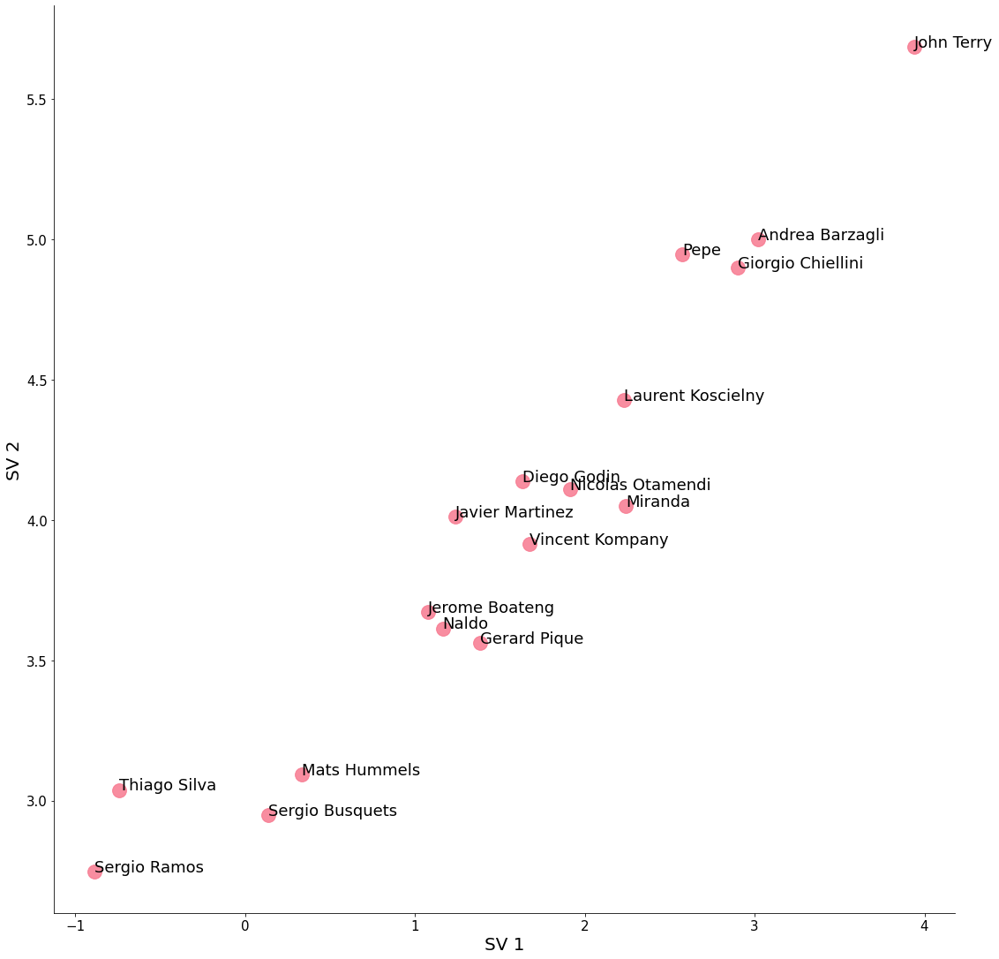

In [63]:
clust_3 = reduced.loc[reduced['cluster'] == 3]
%matplotlib inline
# sns.set(style="white")
ax = sns.lmplot(x="x", y="y", palette= 'husl', hue='cluster', data = clust_3, legend=False,
fit_reg=False, size = 15, scatter_kws={"s": 250})
texts = []
for x, y, s in zip(clust_3.x, clust_3.y, clust_3.name):
    texts.append(plt.text(x, y, s, fontstretch='ultra-expanded', fontsize='18'))
# ax.set(ylim=(-6, 6))
plt.tick_params(labelsize=15)
plt.xlabel("SV 1", fontsize = 20)
plt.ylabel("SV 2", fontsize = 20)
plt.show();

Even with the use of K-means clustering, we can identify player positions based on the clusters. Of course, it could have been something else entirely. But since our features were heavily dominated by player attributes, the clusters will likely be player positions. It might be a different story however if we use some other clustering technique.

Do you think we can identify a more specialized role for players using clustering? We just might! But let's leave it for another time as it is outside the scope of this study. But you see where we are going right?

<h2 style="color:#000000">Clustering by Year Groups</h2>

Clustering the data grouped by year provides important insights in sports such as football. This analysis will help us identify trends and the evolution of the game between timelines. As the game evolves, so are the players as they align their skillsets based on the current meta of the game. In this analysis, we select only 3 years (2007, 2012, and 2016) from the 10 year span. The reason for this is to match the datapoints per year as the other years have either very high or low datapoints which create biased interpretations.

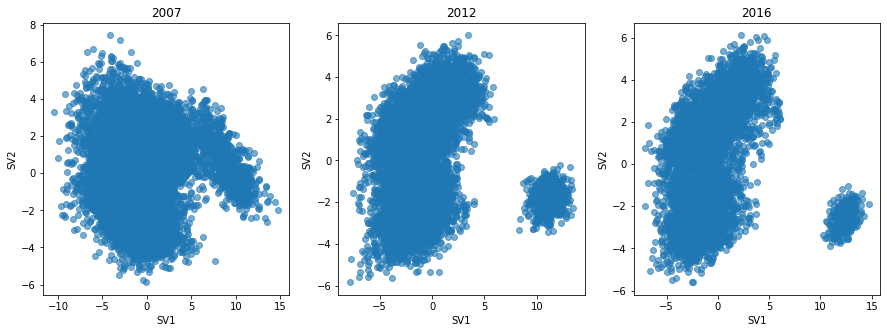

In [64]:
df_soccer_year['date'] = pd.to_datetime(df_soccer_year['date']).dt.strftime('%Y')
df_soccer_year

year = np.sort(df_soccer_year['date'].unique())
year = ['2007', '2012', '2016']
fig, ax = plt.subplots(1, len(year), figsize=(15, 5))
for index, yr in enumerate(year):
    df_soccer_yearx = df_soccer_year.loc[(df_soccer_year['date'] == yr)].groupby('player_fifa_api_id').mean()
    standard_scaler = StandardScaler()
    X_soccer_year = standard_scaler.fit_transform(df_soccer_yearx)
    svd_year = TruncatedSVD(n_components=6, random_state=1337)
    year_new_svd = svd_year.fit_transform(X_soccer_year)
    ax[index].scatter(year_new_svd[:,0], year_new_svd[:,1], alpha=0.6);
    ax[index].set_title(f'{yr}')
    ax[index].set_xlabel('SV1')
    ax[index].set_ylabel('SV2')

The initial plot of the per year dataset can already provide insights on the trend of player attributes. One specific trend is the specialization of a specific blob. Notice that in 2007, the attributes of this group are closer to the rest of the players. In 2011, the group already separated itself from the other group which intuitively should be labeled as 1 cluster. For the lastest year, it can be visualized that the cluster becomes more compact and separated from the other cluster/s. This suggests that players in the said cluster are almost similar in attributes to each other. The specialization of players is the outcome of the integration of technology and data-driver methods to sports so specific attributes are identified for a specific position or role. Player can spend more time honing a specific skillset than improve on a number of attributes but end up using less in a game. This specialization is also seen in the bigger blob as it becomes more compact as year goes.

Another insight is the shift of the datapoints from negative SV1 to positive SV1. As noted above SV1 is characterized by shot making, finishing and acceleration which are attributes closely related to offense. This shift in the plot suggests that the style of football in focused on offense rather than defense as more players are defined in the positive SV1.

100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


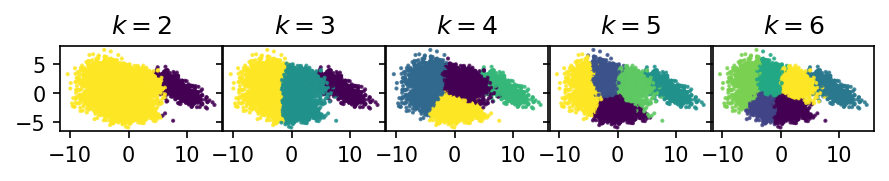

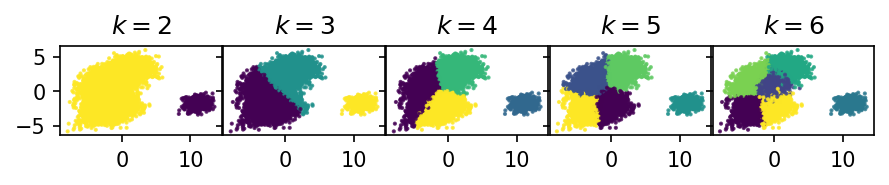

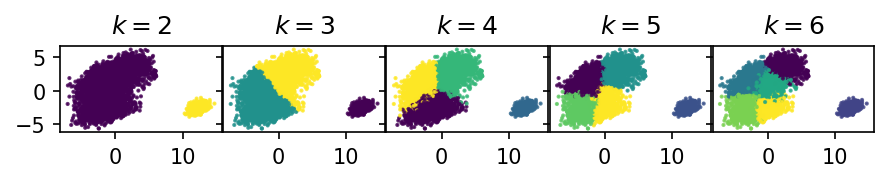

In [65]:
for index, yr in enumerate(year):
    df_soccer_yearx = df_soccer_year.loc[(df_soccer_year['date'] == yr)].groupby('player_fifa_api_id').mean()

    standard_scaler = StandardScaler()
    X_soccer_year = standard_scaler.fit_transform(df_soccer_yearx)

    svd_year = TruncatedSVD(n_components=6, random_state=1337)
    year_new_svd = svd_year.fit_transform(X_soccer_year)
    
    res_agri = cluster_range(year_new_svd, KMeans(random_state=1337), 2, 6)
    plot_clusters_year(year_new_svd, res_agri['ys'], res_agri['centers'])

The clustering for the three periods of interest have almost similar characteristics and visualization as the previous clustering plots. The main difference is that in 2007, the smaller cluster is not separated with the bigger cluster/s resulting to overlapping cluster even if k=2. Aside from this, the clustering of the three years are identical in terms of visualization. To distinguish each year, we can look at the values of the attributes and analyze the differences and trends.

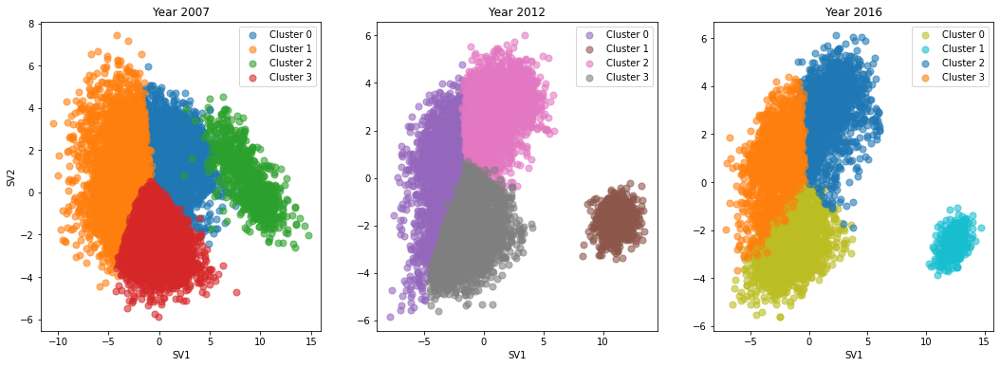

In [66]:
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

df_soccer_2007 = df_soccer_year.loc[(df_soccer_year['date'] == '2007')].groupby('player_fifa_api_id').mean()
standard_scaler = StandardScaler()
X_soccer_year = standard_scaler.fit_transform(df_soccer_2007)
svd_year = TruncatedSVD(n_components=6, random_state=1337)
year_new_svd = svd_year.fit_transform(X_soccer_year)
cluster_labels = KMeans(4, random_state=1337).fit_predict(year_new_svd)
df_soccer_2007['cluster'] = cluster_labels

labels = {0: "Cluster 0", 1: "Cluster 1", 2: "Cluster 2", 3: "Cluster 3", 4: "Cluster 4"}
colors = cycle(cm.tab10.colors)
for i in range(4):
    color = next(colors)
    idx = cluster_labels == i
    ax[0].scatter(year_new_svd[idx,0], year_new_svd[idx,1], color=color, s=50,
                  label=labels[i], alpha=0.6)
    ax[0].legend(loc="upper right")
    ax[0].set_title('Year 2007')
    ax[0].set_ylabel('SV2')
    ax[0].set_xlabel('SV1')
    
df_soccer_2012 = df_soccer_year.loc[(df_soccer_year['date'] == '2012')].groupby('player_fifa_api_id').mean()
standard_scaler = StandardScaler()
X_soccer_year = standard_scaler.fit_transform(df_soccer_2012)
svd_year = TruncatedSVD(n_components=6, random_state=1337)
year_new_svd = svd_year.fit_transform(X_soccer_year)
cluster_labels = KMeans(4, random_state=1337).fit_predict(year_new_svd)
df_soccer_2012['cluster'] = cluster_labels

for i in range(4):
    color = next(colors)
    idx = cluster_labels == i
    ax[1].scatter(year_new_svd[idx,0], year_new_svd[idx,1], color=color, s=50,
                  label=labels[i], alpha=0.6)
    ax[1].legend(loc="upper right")
    ax[1].set_title('Year 2012')
    ax[1].set_xlabel('SV1')



df_soccer_2016 = df_soccer_year.loc[(df_soccer_year['date'] == '2016')].groupby('player_fifa_api_id').mean()
stanard_scaler = StandardScaler()
X_soccer_year = standard_scaler.fit_transform(df_soccer_2016)
svd_year = TruncatedSVD(n_components=6, random_state=1337)
year_new_svd = svd_year.fit_transform(X_soccer_year)
cluster_labels = KMeans(4, random_state=1337).fit_predict(year_new_svd)
df_soccer_2016['cluster'] = cluster_labels

for i in range(4):
    color = next(colors)
    idx = cluster_labels == i
    ax[2].scatter(year_new_svd[idx,0], year_new_svd[idx,1], color=color, s=50,
                  label=labels[i], alpha=0.6);
    ax[2].legend(loc="upper right")
    ax[2].set_title('Year 2016')
    ax[2].set_xlabel('SV1')

Similar to the previous clusters, we select four clusters as our point of analysis to compare the three periods. For 2007, the overlap between cluster 0 and cluster 2 are highlighted which is one of the differences from the other years having a clearly separated cluster. The points of the cluster 2 (green) in 2007 is dispersed but as time goes, the cluster becomes more compact as shown in 2016 by cluster 1 (turquoise). For the other clusters, the main trend is that the overlap between clusters are becoming more frequent as time shifts to present. This could mean that players along the boundary of clusters can have the minimum attributes needed to play another position.

<h1 style="color:#000000">VIII. Results and Discussion</h1>

<span style="font-size: 20px"><b>What is our optimal k value?</b></span>

There are many techniques that we can apply to our dataset to identify the natural clusters within our data. At this point, we have already applied K-means, K-medoids, single linkage, complete linkage, average linkage, Ward's linkage, DBSCAN, and OPTICS. All of these clustering algorithms point towards a single direction, where our resulting optimal k value is k=2.

<span style="font-size: 20px"><b>How do we interpret the clustering labels?</b></span>

Labeling our clusters may vary depending on a specific use case. One of our goals in this study is to label the clusters identified by our clustering algorithm. It's a matter of answering the question: What certain aspects of our features cluster the data in two parts?

Luckily for us, we experimented with how we can interpret the data when there are four clusters in our data. Our experiment revealed that the lower right cluster of our data is goalkeepers while the large cluster found on the left side are defenders, midfielders, and forwards. From this, we can label the small cluster on the right as players who are allowed to use their hands and the left big cluster as players who are not allowed to use their hands. We can also call them as goalkeepers and regular players.

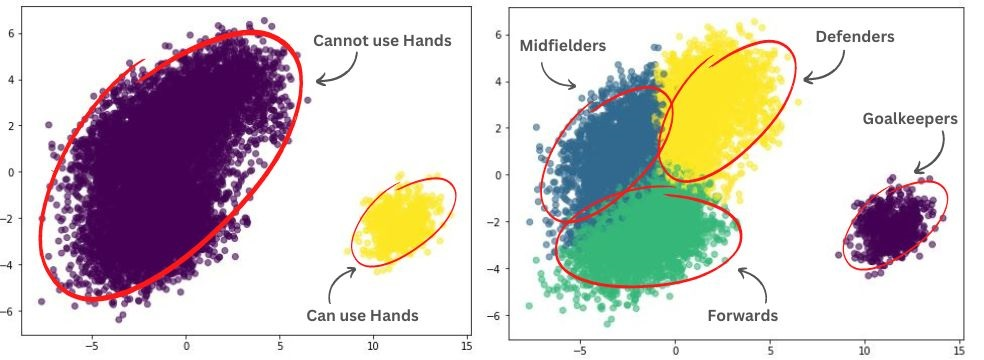|

<span style="font-size: 20px"><b>What part of the data separates the two clusters?</b></span>

One thing that separates goalkeepers from regular players is that the former is allowed to touch the ball with their hands, at least in the penalty area, while regular players can only do so with their feet. However, that is part of the rules of soccer and it is not found anywhere in our data. There is another aspect of the data that separates both, it is the stats. 

Goalkeepers are considered outliers in soccer. They have absurdly high goalkeeping stats but have poor stats elsewhere. It is the very reason why there is a wide and dense whitespace that separates the two clusters. The divergence in stats becomes more evident once we plot the data in a radar chart

<span style="font-size: 20px"><b>How do we interpret the various clusters?</b></span>

All Unique Players Attributes


,height,weight,age,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,188.225287,184.427586,29.956322,68.043678,70.066667,2.000000,2.000000,16.041379,15.583908,16.160920,28.041379,16.279310,16.256322,16.442529,16.273563,26.940230,22.121839,42.893103,43.028736,45.087356,64.854023,44.543678,24.801149,63.200000,34.425287,65.010345,16.300000,30.904598,20.919540,15.272414,33.493103,22.806897,15.665517,15.927586,16.065517,69.691954,66.089655,64.050575,67.605747,71.003448,0.860920
1,179.079360,163.734302,27.002035,67.912500,71.212791,2.326453,1.775000,59.088663,64.822384,57.740407,64.682267,61.076453,68.873256,60.727907,55.072093,55.377326,69.322384,72.562791,72.376744,72.118023,65.222965,69.052616,68.781977,64.933721,64.370640,63.818895,62.526163,53.828779,33.684012,66.772965,61.996221,63.240988,27.961919,31.965988,29.069477,10.500291,10.577907,10.439826,10.453488,10.388953,0.784302
2,179.163597,163.968942,28.206934,71.829180,73.794511,2.319610,2.244493,66.862405,53.428675,61.427230,72.384977,54.979776,67.774287,63.879379,59.435175,68.860599,71.761647,69.094619,68.938245,69.777176,70.915854,69.550379,70.536656,69.335861,74.508848,69.256410,63.592994,71.506320,67.419646,62.276273,65.990249,59.185265,63.227880,68.101481,65.627663,10.520043,10.481762,10.553991,10.502709,10.464066,0.687252
3,184.047719,173.444211,27.948070,65.325614,68.386316,1.933684,2.214386,47.820351,33.869123,63.553684,59.225263,35.012632,48.881053,41.207018,39.154737,54.841053,57.177544,58.064912,59.697544,55.407018,61.422105,57.251930,54.151930,66.542456,64.362105,73.841754,40.015088,68.591930,63.758947,39.949825,46.583509,44.637544,63.983158,66.638947,63.947018,10.436140,10.298246,10.414737,10.485965,10.417193,0.753333


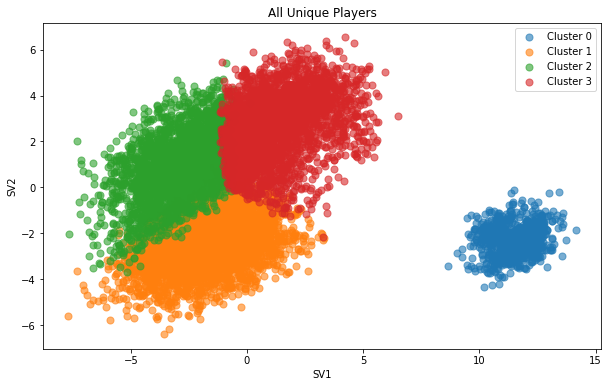

In [67]:
pd.options.display.max_columns = None
pd.options.display.max_rows = None

cluster_labels = KMeans(4, random_state=1337).fit_predict(X_new_svd)
X_soccer_unscaled['cluster'] = cluster_labels

df_all = pd.DataFrame()
df_all['Shooting'] = X_soccer_unscaled.groupby('cluster').mean()[shooting].mean(axis=1)
df_all['Ball_control'] = X_soccer_unscaled.groupby('cluster').mean()[ball_control].mean(axis=1)
df_all['Passing'] = X_soccer_unscaled.groupby('cluster').mean()[passing].mean(axis=1)
df_all['Defense'] = X_soccer_unscaled.groupby('cluster').mean()[defense].mean(axis=1)
df_all['Physical'] = X_soccer_unscaled.groupby('cluster').mean()[physical].mean(axis=1)
df_all['Goalkeeping'] = X_soccer_unscaled.groupby('cluster').mean()[goalkeeping].mean(axis=1)

print('All Unique Players Attributes')
display(X_soccer_unscaled.groupby('cluster').mean())

fig, ax = plt.subplots(figsize=(10, 6))
colors = cycle(cm.tab10.colors)
for i in range(4):
    color = next(colors)
    idx = cluster_labels == i
    ax.scatter(X_new_svd[idx,0], X_new_svd[idx,1], color=color, s=50,
                  label=labels[i], alpha=0.6)
    ax.legend(loc="upper right")
    ax.set_title('All Unique Players')
    ax.set_ylabel('SV2')
    ax.set_xlabel('SV1')

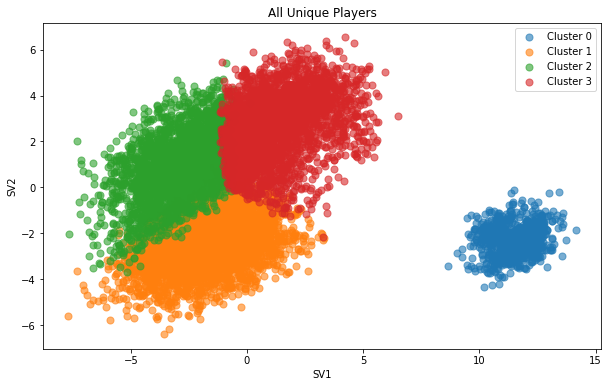

In [68]:
fig, ax = plt.subplots(figsize=(10, 6))
colors = cycle(cm.tab10.colors)
for i in range(4):
    color = next(colors)
    idx = cluster_labels == i
    ax.scatter(X_new_svd[idx,0], X_new_svd[idx,1], color=color, s=50,
                  label=labels[i], alpha=0.6)
    ax.legend(loc="upper right")
    ax.set_title('All Unique Players')
    ax.set_ylabel('SV2')
    ax.set_xlabel('SV1')

In [80]:
radarplot([df_all], ['All Unique Players Attributes '], 500, 1100, [0, 80])
plt.close();

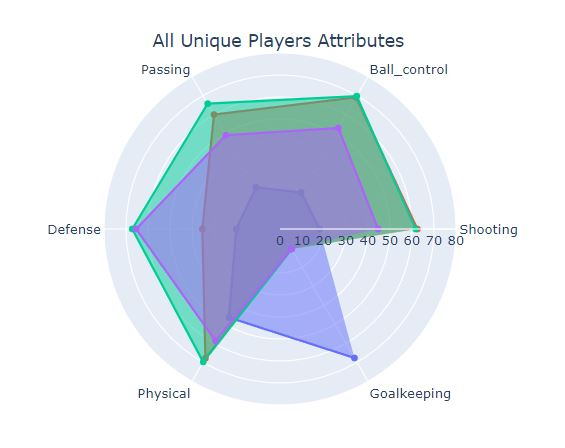

By looking at the average values of the attributes of the clusters, we can see how each cluster differ from each and justify the positions we set for each cluster.
1. **Mid-Fielder** - Players with all around stats except for goalkeeping. Since they excel at both offensive and defensive areas of the game, they are positioned in the middle of the field to play based on the needs of the team. The only fault in their attributes are the goalkeeping skills. Other notable features are they have the highest overall rating and potential compared to the other clusters.
2. **Striker** - Players with offensive and physical attributes on par with mid-fielders however they lack both the defensive skills and goalkeeping skillsets. They should be placed on the opponent's half to utilize their scoring capabilities and to hide their lack of defensive stats. Other notable features are have the lowest average age, plus their height and weight are similar with mid-fielder being the lowest ones. They make up for this by having the highest speed.
3. **Defenders** - Players that are defensive specialist but lacks physical and offensive skills. These players are the ones placed on their side of the field in order to stop the opposing players from scoring. They are also defined by high height and weight but also have the lowest overall rating and potential. Main reason for the low rating is that defensive plays are often not recorded in the stats.
4. **Goalkeepers** - Players specializing in goalkeeping but are the lowest in all other attributes. They are the players closest to the goal post and have a definite role. Other notable features of these players are highest height, weight age. 

In [70]:
cluster_labels = KMeans(4, random_state=1337).fit_predict(X_new_svd_high)
X_soccer_unscaled_high['cluster'] = cluster_labels

df_high = pd.DataFrame()
df_high['Shooting'] = X_soccer_unscaled_high.groupby('cluster').mean()[shooting].mean(axis=1)
df_high['Ball_control'] = X_soccer_unscaled_high.groupby('cluster').mean()[ball_control].mean(axis=1)
df_high['Passing'] = X_soccer_unscaled_high.groupby('cluster').mean()[passing].mean(axis=1)
df_high['Defense'] = X_soccer_unscaled_high.groupby('cluster').mean()[defense].mean(axis=1)
df_high['Physical'] = X_soccer_unscaled_high.groupby('cluster').mean()[physical].mean(axis=1)
df_high['Goalkeeping'] = X_soccer_unscaled_high.groupby('cluster').mean()[goalkeeping].mean(axis=1)

cluster_labels = KMeans(4, random_state=1337).fit_predict(X_new_svd_mid)
X_soccer_unscaled_mid['cluster'] = cluster_labels

df_mid = pd.DataFrame()
df_mid['Shooting'] = X_soccer_unscaled_mid.groupby('cluster').mean()[shooting].mean(axis=1)
df_mid['Ball_control'] = X_soccer_unscaled_mid.groupby('cluster').mean()[ball_control].mean(axis=1)
df_mid['Passing'] = X_soccer_unscaled_mid.groupby('cluster').mean()[passing].mean(axis=1)
df_mid['Defense'] = X_soccer_unscaled_mid.groupby('cluster').mean()[defense].mean(axis=1)
df_mid['Physical'] = X_soccer_unscaled_mid.groupby('cluster').mean()[physical].mean(axis=1)
df_mid['Goalkeeping'] = X_soccer_unscaled_mid.groupby('cluster').mean()[goalkeeping].mean(axis=1)

cluster_labels = KMeans(4, random_state=1337).fit_predict(X_new_svd_low)
X_soccer_unscaled_low['cluster'] = cluster_labels

df_low = pd.DataFrame()
df_low['Shooting'] = X_soccer_unscaled_low.groupby('cluster').mean()[shooting].mean(axis=1)
df_low['Ball_control'] = X_soccer_unscaled_low.groupby('cluster').mean()[ball_control].mean(axis=1)
df_low['Passing'] = X_soccer_unscaled_low.groupby('cluster').mean()[passing].mean(axis=1)
df_low['Defense'] = X_soccer_unscaled_low.groupby('cluster').mean()[defense].mean(axis=1)
df_low['Physical'] = X_soccer_unscaled_low.groupby('cluster').mean()[physical].mean(axis=1)
df_low['Goalkeeping'] = X_soccer_unscaled_low.groupby('cluster').mean()[goalkeeping].mean(axis=1)


print('High Skill Players')
display(X_soccer_unscaled_high.groupby('cluster').mean())
print('Mid Skill Players')
display(X_soccer_unscaled_mid.groupby('cluster').mean())
print('Low Skill Players')
display(X_soccer_unscaled_low.groupby('cluster').mean())

High Skill Players


,height,weight,age,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,187.823529,181.705882,29.882353,85.294118,85.529412,2.176471,2.411765,55.352941,46.470588,84.411765,71.941176,50.411765,59.588235,52.941176,48.647059,70.000000,69.411765,65.529412,69.882353,62.764706,81.823529,56.647059,69.882353,78.647059,71.588235,83.000000,53.176471,82.235294,87.058824,47.470588,61.764706,56.470588,85.705882,88.058824,87.000000,9.294118,8.411765,9.000000,8.705882,8.941176,0.941176
1,179.258065,167.225806,27.064516,86.774194,88.258065,2.741935,1.838710,77.709677,83.774194,66.709677,82.290323,81.774194,87.000000,81.129032,76.612903,72.096774,87.451613,83.967742,82.387097,83.774194,85.774194,74.580645,82.451613,70.548387,78.645161,70.935484,81.548387,64.129032,40.419355,86.000000,82.580645,78.419355,26.709677,36.322581,32.419355,10.580645,10.000000,10.741935,9.903226,10.806452,0.709677
2,193.375000,193.250000,29.500000,85.750000,86.625000,2.000000,2.000000,14.625000,12.625000,15.125000,34.375000,14.000000,16.250000,15.875000,13.750000,34.750000,26.000000,53.375000,55.375000,51.500000,82.875000,41.000000,30.375000,70.375000,36.000000,65.000000,15.125000,28.625000,23.750000,13.000000,45.250000,35.000000,12.250000,13.375000,13.375000,85.375000,82.625000,75.875000,85.875000,86.875000,0.625000
3,176.652174,162.043478,28.739130,85.086957,85.869565,2.565217,2.260870,79.043478,70.043478,63.826087,86.565217,73.782609,82.521739,79.782609,75.173913,83.739130,85.913043,72.347826,71.130435,79.043478,85.304348,78.130435,77.521739,67.565217,79.304348,68.043478,77.565217,70.434783,74.913043,78.043478,84.173913,75.304348,64.260870,72.000000,68.304348,8.826087,10.391304,9.217391,8.956522,9.391304,0.869565


Mid Skill Players


,height,weight,age,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,186.271941,178.862794,28.883807,73.556242,75.058096,1.855377,2.327565,46.934487,33.925834,73.873918,64.284302,35.611867,49.478368,41.864030,39.689740,60.504326,61.296663,56.435105,59.725587,52.932015,68.864030,53.404203,59.357231,71.351051,65.415328,80.138443,42.017305,76.576020,73.851669,38.744129,47.730532,46.278121,74.411619,76.478368,73.358467,10.610630,10.351051,10.608158,10.598269,10.642769,0.793572
1,178.894702,164.152980,27.528477,74.034437,76.295364,2.435762,1.797351,66.076159,70.961589,61.164901,71.149007,68.072848,75.223179,68.676159,62.733113,61.535099,76.097351,75.254305,74.754967,75.304636,72.017219,70.968874,74.587417,66.609934,68.182781,65.578808,69.591391,58.080132,36.467550,73.629139,69.066225,68.613907,28.778808,34.539073,30.525166,10.507285,10.639073,10.494702,10.465563,10.368874,0.758940
2,179.265591,164.103448,27.790169,74.261922,76.136464,2.364637,2.307410,69.242847,53.887014,63.113720,74.648569,55.551724,69.727073,65.044754,59.239178,71.157007,73.969186,70.535583,70.520176,70.757887,73.358767,70.132062,72.154072,70.859868,77.393250,70.576669,64.735877,74.430668,71.919296,64.343360,67.369773,59.303742,67.783566,72.617021,70.409391,10.489362,10.424798,10.617755,10.622891,10.438738,0.699193
3,188.301493,185.546269,30.352239,74.340299,75.588060,2.000000,2.000000,14.994030,14.310448,14.958209,28.946269,15.283582,15.089552,15.540299,15.274627,28.322388,21.800000,45.501493,45.280597,47.904478,71.343284,46.161194,24.513433,67.268657,35.002985,66.949254,15.262687,32.489552,21.107463,13.808955,39.017910,22.934328,14.286567,14.713433,14.785075,76.110448,72.158209,68.973134,74.005970,77.641791,0.862687


Low Skill Players


,height,weight,age,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,179.663542,164.503125,26.631250,64.211979,68.185937,2.260937,1.763021,54.480208,61.639583,56.194792,60.459896,57.142708,64.876563,55.490625,49.919271,51.016146,65.018750,70.615104,70.668229,69.588542,60.945312,67.073958,65.455208,63.730729,61.695833,63.530208,58.239583,50.902083,31.029167,62.626562,57.402083,60.390104,26.674479,29.604167,27.315104,10.555208,10.560417,10.410937,10.489583,10.427083,0.808854
1,188.098672,183.582543,29.711575,63.772296,66.305503,2.000000,2.000000,16.728653,16.438330,16.941176,27.370019,16.946869,16.998102,17.024668,16.946869,25.943074,22.267552,41.075901,41.409867,43.199241,60.455408,43.569260,24.899431,60.504744,34.034156,63.777989,16.977230,29.931689,20.757116,16.237192,29.802657,22.540797,16.593928,16.738140,16.920304,65.373814,61.981025,60.741935,63.259962,66.542694,0.863378
2,184.613480,174.140303,27.242091,62.581843,66.477304,1.891334,2.188446,44.747593,30.741403,61.438790,55.735213,31.987620,45.232462,37.685695,36.295736,51.241403,53.568776,56.709766,58.248281,53.301238,58.176066,55.675378,50.132050,64.768226,62.870014,73.500688,35.791609,65.932600,60.936726,36.101100,43.166437,42.169876,61.599725,64.314305,61.565337,10.407840,10.334938,10.391334,10.514443,10.262036,0.749656
3,178.733954,162.682195,28.509834,65.111801,67.685300,2.206522,2.159938,60.941511,47.292961,56.678571,66.076087,48.394410,61.754658,57.150104,54.081781,62.531056,65.333851,66.033126,65.700311,67.102484,64.040373,68.597826,63.754141,66.516046,69.601449,66.087992,56.332816,66.746894,61.490166,55.783126,59.785714,54.030021,58.504658,62.537785,60.324534,10.434265,10.413561,10.415114,10.342650,10.488095,0.675983


In [82]:
radarplot([df_high, df_mid, df_low], ['High Skill', 'Mid Skill', 'Low Skill '],
         400, 1100, [0, 90])
plt.close();

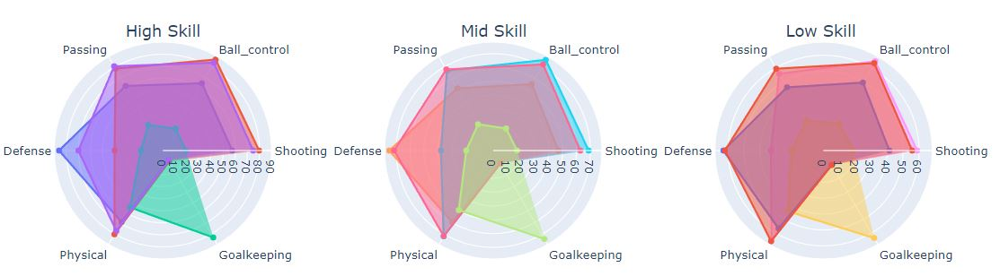

Dividing the players into their skill tiers before clustering have minimal changes in the clustering behavior. The same pattern on the specialization of each cluster can be observed. However the changes can be observed on the high skilled players, especially the defensive attributes of defenders having a huge separation from mid-fielders. Another is that forwards have a noticeable edge in the physical attributes in the high skill.

In [72]:
df_2007 = pd.DataFrame()
df_2007['Shooting'] = df_soccer_2007.groupby('cluster').mean()[shooting].mean(axis=1)
df_2007['Ball_control'] = df_soccer_2007.groupby('cluster').mean()[ball_control].mean(axis=1)
df_2007['Passing'] = df_soccer_2007.groupby('cluster').mean()[passing].mean(axis=1)
df_2007['Defense'] = df_soccer_2007.groupby('cluster').mean()[defense].mean(axis=1)
df_2007['Physical'] = df_soccer_2007.groupby('cluster').mean()[physical].mean(axis=1)
df_2007['Goalkeeping'] = df_soccer_2007.groupby('cluster').mean()[goalkeeping].mean(axis=1)

df_2012 = pd.DataFrame()
df_2012['Shooting'] = df_soccer_2012.groupby('cluster').mean()[shooting].mean(axis=1)
df_2012['Ball_control'] = df_soccer_2012.groupby('cluster').mean()[ball_control].mean(axis=1)
df_2012['Passing'] = df_soccer_2012.groupby('cluster').mean()[passing].mean(axis=1)
df_2012['Defense'] = df_soccer_2012.groupby('cluster').mean()[defense].mean(axis=1)
df_2012['Physical'] = df_soccer_2012.groupby('cluster').mean()[physical].mean(axis=1)
df_2012['Goalkeeping'] = df_soccer_2012.groupby('cluster').mean()[goalkeeping].mean(axis=1)

df_2016 = pd.DataFrame()
df_2016['Shooting'] = df_soccer_2016.groupby('cluster').mean()[shooting].mean(axis=1)
df_2016['Ball_control'] = df_soccer_2016.groupby('cluster').mean()[ball_control].mean(axis=1)
df_2016['Passing'] = df_soccer_2016.groupby('cluster').mean()[passing].mean(axis=1)
df_2016['Defense'] = df_soccer_2016.groupby('cluster').mean()[defense].mean(axis=1)
df_2016['Physical'] = df_soccer_2016.groupby('cluster').mean()[physical].mean(axis=1)
df_2016['Goalkeeping'] = df_soccer_2016.groupby('cluster').mean()[goalkeeping].mean(axis=1)

pd.options.display.max_columns = None
pd.options.display.max_rows = None

print('Year 2007')
display(df_soccer_2007.groupby('cluster').mean())
print('Year 2012')
display(df_soccer_2012.groupby('cluster').mean())
print('Year 2016')
display(df_soccer_2016.groupby('cluster').mean())

Year 2007


,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,59.054173,68.152046,1.993781,2.154501,44.355974,31.635352,54.786907,53.097872,33.847136,43.965466,39.832079,38.243372,48.237971,52.030933,62.103110,62.900327,58.356465,56.680524,63.310311,46.584124,66.040917,63.048609,64.679051,35.738789,60.875777,54.699509,44.050082,48.053682,45.492962,57.933224,60.861047,61.383961,9.106547,13.760556,25.360393,13.904092,13.801309,0.750082
1,71.345351,77.471449,2.194363,2.055271,62.605600,57.431735,63.287701,69.077233,58.498536,65.665264,61.504758,60.073206,62.344253,70.215776,72.832174,73.238653,69.527452,68.437042,70.877745,66.744876,68.398243,73.338214,68.420022,61.144766,65.396413,65.784407,68.251830,68.852855,64.972914,53.683382,56.102123,54.381040,9.351574,15.885981,53.001098,15.904649,15.921120,0.714495
2,62.652474,70.436709,2.000000,1.999425,20.412543,19.642117,21.643843,27.715190,15.383774,20.546605,16.239356,23.705409,47.516110,24.608170,46.132336,46.155926,48.323360,55.708861,50.816456,29.573072,63.593211,47.786536,59.871116,19.084005,39.485040,37.632336,27.364787,36.340621,39.532796,20.262946,21.441887,17.717491,64.100115,61.304373,59.944764,61.048331,65.539701,0.920023
3,59.841083,70.042827,2.231875,1.856225,49.481646,56.803304,51.261548,55.713215,54.553686,60.799021,52.960538,46.483481,47.506577,60.468798,68.528449,68.606608,67.917406,57.736158,65.106149,59.196543,60.614867,58.395381,55.381309,53.110584,45.232946,36.849801,54.213521,56.217804,52.992658,27.930101,29.986387,29.801468,8.882227,13.949526,23.966351,13.864485,13.835730,0.796574


Year 2012


,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,73.276500,76.789750,2.322000,2.145500,68.356250,57.619750,62.393000,73.603000,59.520250,69.929500,65.553250,62.182250,69.099000,73.863500,71.833750,71.756250,71.587000,72.705500,69.294000,72.608750,68.551750,74.961750,69.028500,66.434750,69.986750,62.072500,65.205250,68.970750,62.468500,56.761750,62.579000,59.756750,10.080500,10.012500,10.107500,9.966750,9.988250,0.693250
1,67.779883,71.812682,2.000000,2.000000,13.734694,13.182216,13.683673,26.719388,14.077988,13.923469,13.843294,13.950437,25.889942,23.481778,47.036443,47.621720,49.244169,61.469388,46.331633,28.061224,64.797376,45.852284,65.727405,13.843294,38.924198,21.219388,13.766764,28.967930,22.873178,13.523324,13.752187,14.000729,69.514091,66.174198,63.838435,66.950194,70.851798,0.882653
2,65.272394,69.890396,1.947674,2.182601,49.426572,33.838286,63.151593,59.747631,35.639750,48.166882,42.100345,40.344531,55.382644,58.004737,60.714255,61.827519,57.384582,62.395995,58.768088,54.688630,66.698105,66.543066,72.751507,41.032946,68.889320,63.951335,40.374031,49.811154,44.797804,64.010982,66.753230,63.927003,10.096469,9.927864,10.073643,10.032300,10.100560,0.723945
3,66.209932,71.723998,2.219949,1.788789,56.672421,62.849318,56.327153,62.291986,58.751918,66.908142,57.644714,53.098465,52.480818,67.247869,72.755754,72.408142,71.469096,64.193308,68.402813,66.648551,64.916667,63.923913,62.203751,59.865942,51.657928,33.457801,64.629156,59.802430,60.484228,27.124467,31.087596,28.036871,9.997869,10.161552,10.121697,10.137894,9.885124,0.776641


Year 2016


,overall_rating,potential,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,acceleration,sprint_speed,agility,reactions,balance,shot_power,jumping,stamina,strength,long_shots,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,69.563300,73.193678,2.390347,1.799999,60.371613,66.659833,58.250168,66.205309,62.553588,70.695128,62.358838,55.991546,56.673644,71.091291,74.391589,74.114864,73.636331,66.693256,69.866885,70.316674,65.582686,66.496867,64.021466,64.368676,54.826458,33.988101,68.237926,63.454295,64.476348,27.668432,32.180263,29.172114,10.706835,10.771899,10.649873,10.641519,10.617215,0.769554
1,69.903078,72.184599,2.000000,2.000000,14.148780,13.487805,14.399187,28.185041,14.275610,14.430081,14.705691,14.248780,27.168496,21.465041,44.034344,44.058537,45.805981,66.938415,45.223868,23.359582,64.476156,33.348931,64.960569,14.463066,29.295209,20.212776,12.990767,36.967213,21.778049,13.619512,13.851220,13.985976,72.011736,67.435842,65.732863,69.155801,73.413966,0.848780
2,66.968982,70.581622,1.975768,2.251394,48.581287,33.565446,64.357393,60.348808,34.609279,50.534056,41.624692,38.145348,55.876610,58.315745,60.340041,62.180346,56.665270,62.756485,57.900265,54.212905,68.306397,66.337229,73.526228,39.571233,69.427908,65.741441,40.472047,46.260785,44.275140,66.128819,69.039288,66.666434,10.766355,10.538051,10.712951,10.863818,10.740320,0.772363
3,73.214140,75.556979,2.375257,2.277785,67.951976,54.866706,62.038678,73.596597,56.148516,69.533275,64.932338,60.127184,69.971652,73.146549,70.776388,70.727917,71.122811,72.096267,69.723877,71.782676,69.955042,77.016532,69.726533,65.003218,72.507636,68.642487,63.999440,67.248148,59.365142,64.295140,69.630730,67.123683,10.568460,10.574572,10.693154,10.603301,10.515281,0.688657


In [81]:
radarplot([df_2007, df_2012, df_2016], ['Year 2007 ', 'Year 2012 ', 'Year 2016 '],
         400, 1100, [0, 70])
plt.close();

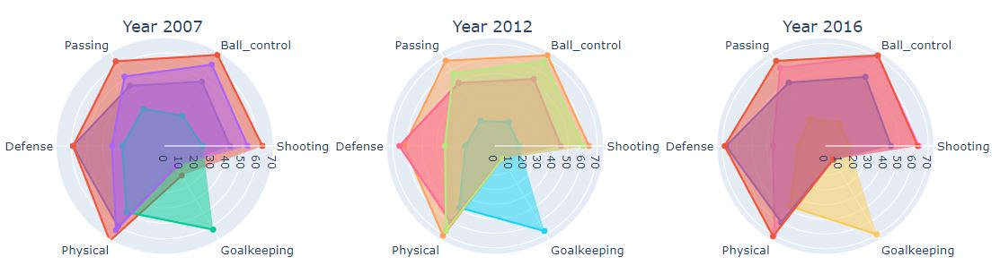

Lastly, looking at the clusters of the players by year can provide insights on the trend of the game. This is evident in the comparison of the mid-fielders and forwards. In 2007, the attributes of the clusters can be distinguished since they are separated in the radar chart. However as time goes, the skillsets of the forwards in the shooting, ball control and passing have closed in on the attributes of the mid-fielders. This can be the result of the shift in the gameplay and strategy of teams where offense is priotized thus more skilled offensive players are gaining traction in the sport. On the other side, defenders overtook mid-fielders in defensive skillsets in 2012 but lost its advantage in 2016. This can also be the result of forwards having improvements so mid-fielders are placed on the defensive plays and positions. For the goalkeepers, we can see that their chart is getting more compact as a result of them being specialized and not honing skills not needed in their position.

By looking at the different period and the clustering, we can imply that the clustering and their label across the years are the same. But checking their values, we can see the changes in the attributes of the clusters that are influenced by the trends and strategies for that specific year. The gradual changes in the attributes per year can lead to a different clustering and labels once they accumulate and become significant. However this needs additional data for the latest periods in order to be analyzed and compared with the working dataset. 

<h1 style="color:#000000">IX. Conclusion</h1>

In this report, we have applied several pre-processing and  clustering techniques to extract insights from the data. We summarize our findings and realizations in the following statements:

1. It is equally important to perform a data exploration before thinking about dimensionality reduction and clustering. You will realize that it makes every succeeding step much easier as it will already reveal insights that we can further use in the application of our dimensionality reduction and clustering.

2. Although it is possible to perform clustering at the onset, we should always consider performing dimensionality reduction as it addresses multiple problems and most certainly improve the clustering of our data. Some of these problems may include:

*  Curse of Dimensionality - Adds complexity and difficulty in finding meaningful patterns and relationships in data due to the sheer number of interacting components.
*  Visualization - It is difficult to visualize data in multiple dimensions. By projecting our data onto the two singular vectors with the highest variance, we make sure that clusters in our data will have the highest possible separation.
*  Clustering performance - Reducing the number of features dramatically improves our clustering for two reasons: (1) faster runtimes due to reduced dimensions; (2) and more meaningful clusters due to clear separation of resulting clusters.
*  Noise - Dimensionality reduction removes noise and irrelevant features from the data. In doing so, we can identify specific features that are important to each identified cluster.

3. Using different clustering clustering methods, we found that the optimal number of clusters is k=2. Our data is basically separated into clusters of goalkeepers and non-goalkeepers.

Having arrived at this result, we realized that this conclusion will not help scouts and managers look for specific players or manage their team. So we extend our methodology to perform clustering by overall rating groups and by year-on-year groups. The findings for these analysis are as follows:

4. By sparating the players into different overall rating groups (low, mid, and high tier players) and performing clustering techniques, we found that the optimal number of cluster is still k=2.

5. If we assert that the optimal number of clusters is k=4 in order to separate the main positions in football, we found that we can correctly label and identify clusters of the different positions for the high-tier players.

6. High tier players can be seen at the edges of the clusters which suggests that they have specialized skills or attributes that separate them from the average player.

7. By separating players into different year-on-year groups (2007, 2012, and 2016) and performing clustering techniques with k=4, we are able to assign players to specific clusters.

8. Comparing the clusters per year, we can say that players have evolved and are going in a direction where player roles and positions are much more specialized. This is evidenced by the separation of the goalkeeper cluster and the increasing compactness of clusters through the years. This is an indication that it might be possible to see highly separated clusters in the future.

9. Through radar charts we can also identify which clusters represent specific positions. In doing so, we can also spot trends in dominant strategies by looking at the skill distribution of players at different positions for each year.

<h1 style="color:#000000">X. Recommendations</h1>

- This study can be further improved through the application of other clustering techniques and algorithms which could potentially reveal more meaningful insights from our data. See below for some examples of other clustering techniques and algorithms:
  - Model-based Clustering -This type of clustering assumes that data is a mixture of probabilistic models.
  - Subspace Clustering - This type of clustering finds clusters in subspaces of the feature space rather than the entire feature space.
  - Spectral Clustering - This type of clustering is a graph-based clustering that represents data as a graph and then applies graph theory to partition the graph into clusters.
  - Fuzzy Clustering - This type of clustering allows for a degree of uncertainty or "fuzziness" in assigning data points into clusters.
  - Constrained Clustering - This type of clustering allows users to specify constraints or conditions that must be satisfied by the clustering solution.
  - Deep Clustering - This type of clustering uses deep learning techniques, such as neural networks, to cluster data in an unsupervised manner.
  - Ensemble Clustering - This type of clustering uses multiple clustering algorithms or multiple runs of the same algorithm to produce a final clustering solution. 
  - Self-Organizing Maps (SOM) - This type of clustering uses a neural network approach to create a low-dimensional representation of the data. 
  - Affinity Propagation - This type of clustering algorithm is based on the concept of "message passing" between data points to find the cluster representatives.
  - Mean-Shift Clustering - This type of clustering algorithm is a non-parametric, density-based method that works by shifting "mean" points toward areas of high data density.
  - Gaussian Mixture Models (GMM) - This type of clustering algorithm is a probabilistic method that assumes that the data was generated by a mixture of several Gaussian distributions.

- Clustering the data into more specific potions in soccer. There are four main positions in soccer. These are (1) Forward, (2) Midfielder, (3) Defender, and (4) Goalkeeper. However, as the metagame continuously evolved, more specific roles were introduced into the game. These are:
  - Forward
   - Striker (Center Striker, Right Striker, Left Striker)
   - Forward (Center Forward, Right Forward, Left Forward)
   - Winger (Right Winger, Left Winger)
  - Midfielder
   - Central Midfielder
   - Wide Midfielder
   - Attacking Midfielder
   - Winger
  - Defender
   - Centre-back
   - Sweeper
   - Full-back
   - Wing-back
  - Goalkeeper
  
  It would be a great addition to our insights if our algorithms can cluster the dataset into more specific player positions.
  
- This can also be improved by using the latest 2023 or 2022 data to reflect the current pool of players. Age also affects the data mining process, so it would be better if we can use the updated age of the players. Updating the data also removes retired and inactive players from the active duty pool.

- This study may also be applied to professional soccer and football leagues outside of Europe. This is particularly helpful in creating the national to represent your country in the World Cup.

- This study may also be used not just in soccer but also in other competitive sports. Esports in particular is a very appealing and interesting field of study.

- One way to make the study more interesting is to reveal clusters within clusters. Will we see clusters of elites, highly skilled role players, and low-skilled high potential young players?

<h1 style="color:#000000">XI. References</h1>

FIFPlay. FIFA 22 Attributes Explained12198776. https://www.fifplay.com/fifa-22-player-attributes/

Wright, S. (Oct 2022). <a id="ref2" href="https://www.redbull.com/us-en/soccer-numbers-positions-guide">"Soccer positions and numbers: A complete guide"</a>. Red Bull.

Joshi, S. (Aug 2022). <a id="ref2" href="https://www.analytixlabs.co.in/blog/types-of-clustering-algorithms/">"What is Clustering in Machine Learning: Types and Methods"</a>. AnalytixLabs.

FIFA Index. FIFA Players Database. https://www.fifaindex.com/

EA. FIFA Ratings Database. https://www.ea.com/games/fifa/fifa-21/ratings/ratings-database